### Data Preprocessing, training ML models and Artificial Neural Networks (ANN) with GridSearchCV

1. 1.Import Libraries
2. 1.1 Loading the dataset
3. 2.Data Preprocessing
4. 2.1 Separate for training and test split
5. 2.2 Select categorical, numerical and continuous features
6. 2.3 impute NA values with different methods
7. 2.4 Pipeline, ColumnTransformer, find best parameters impute NA values with GridSearchCV
8. 2.5 Temporary pipeline. Select Mean Imputer for further preprocessing
9. 2.6 Outliers handling
10. 2.7 Discretization with EqualFrequencyDiscretiser
11. 2.8 Discretization with EqualWidthDiscretiser
12. 2.9 DecisionTreeDiscretiser
13. 3.Training ML Models with default parameters
14. 3.1 Preprocessing Pipeline for ML models
15. 3.2 Separate for training and test split to train ANN
16. 3.3 Preprocessing Pipeline for ANN
17. 3.4 Early stopping
18. 3.5 Build the ANN
19. 3.6 GridSearchCV
20. 4.Results
21. 5.Conclusion

1. Import Libraries

In [9]:
# Import basic libraries
import pandas as pd
import numpy as np

# library for show graphs
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats


# library for separate to train and test split
from sklearn.model_selection import train_test_split, KFold

# library for impute missing value
from feature_engine.imputation import MeanMedianImputer, RandomSampleImputer, EndTailImputer, CategoricalImputer

# library for encode and scaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import RobustScaler, MinMaxScaler, MaxAbsScaler, StandardScaler
from category_encoders.woe import WOEEncoder
from feature_engine.encoding import MeanEncoder, CountFrequencyEncoder, WoEEncoder
from feature_engine.encoding import OneHotEncoder as fe_OneHot

# ANN library
import tensorflow as tf
from scikeras.wrappers import KerasRegressor
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization
from keras.optimizers import Adam, SGD, Nadam, RMSprop, Adadelta
from keras.callbacks import EarlyStopping
from scikeras.wrappers import KerasClassifier
from tensorflow.keras.regularizers import l2
from tensorflow.keras import regularizers

#Algorithms
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, BaggingClassifier, ExtraTreesClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier


from sklearn.compose import ColumnTransformer


# Callback, Checkpoint
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler


# metrics score
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, f1_score, recall_score, accuracy_score, precision_score
from sklearn.model_selection import cross_val_score, cross_val_predict

# GridSearchCV
from sklearn.model_selection import GridSearchCV

# Discretization
from feature_engine.discretisation import EqualFrequencyDiscretiser, EqualWidthDiscretiser, DecisionTreeDiscretiser

#Outliers
from feature_engine.outliers import Winsorizer

# feature selection
from feature_engine.selection import (
    DropConstantFeatures,
    DropDuplicateFeatures,
    SmartCorrelatedSelection
)

#Pipeline
from sklearn.pipeline import Pipeline

pd.pandas.set_option('display.max_columns', None)

1.1 Loading the dataset

In [10]:
dataset = pd.read_csv('/Users/shabdantaalaibekov/Documents/KV_AI_JLM_7/Human_Resources_TP.csv')
dataset.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102.0,Sales,1.0,2.0,Life Sciences,1.0,1.0,2.0,Female,94.0,3.0,2.0,Sales Executive,4.0,Single,5993.0,19479.0,8.0,Y,Yes,11.0,3.0,1.0,80.0,0.0,8.0,0.0,1.0,6.0,4.0,0.0,5.0
1,49,No,Travel_Frequently,279.0,Research & Development,8.0,1.0,Life Sciences,1.0,2.0,3.0,Male,61.0,2.0,2.0,Research Scientist,2.0,Married,5130.0,24907.0,1.0,Y,No,23.0,4.0,4.0,80.0,1.0,10.0,3.0,3.0,10.0,7.0,1.0,7.0
2,37,Yes,Travel_Rarely,1373.0,Research & Development,2.0,2.0,Other,1.0,4.0,4.0,Male,92.0,2.0,1.0,Laboratory Technician,3.0,Single,2090.0,2396.0,6.0,Y,Yes,15.0,3.0,2.0,80.0,0.0,7.0,3.0,3.0,0.0,0.0,0.0,0.0
3,33,No,Travel_Frequently,1392.0,Research & Development,3.0,4.0,Life Sciences,1.0,5.0,4.0,Female,56.0,3.0,1.0,Research Scientist,3.0,Married,2909.0,23159.0,1.0,Y,Yes,11.0,3.0,3.0,80.0,0.0,8.0,3.0,3.0,8.0,7.0,3.0,0.0
4,27,No,Travel_Rarely,591.0,Research & Development,2.0,1.0,Medical,1.0,7.0,1.0,Male,40.0,3.0,1.0,Laboratory Technician,2.0,Married,3468.0,16632.0,9.0,Y,No,12.0,3.0,4.0,80.0,1.0,6.0,3.0,3.0,2.0,2.0,2.0,2.0


2. Data Preprocessing 

In [11]:
dataset['Attrition'] = dataset['Attrition'].apply(lambda x: 1 if x == 'Yes' else 0)
dataset['OverTime'] = dataset['OverTime'].apply(lambda x: 1 if x == 'Yes' else 0)
dataset['Gender'] = dataset['Gender'].apply(lambda x: 1 if x == 'Female' else 0) # 0 Male 1 Female

In [12]:
print(dataset.Attrition.unique())
print(dataset.OverTime.unique())
print(dataset.Gender.unique())


[1 0]
[1 0]
[1 0]


In [13]:
# Drop constant feat
dataset.drop(labels = ['EmployeeCount', 'StandardHours', 'Over18', 'EmployeeNumber'], axis = 1, inplace = True)

2.1 Separate for training and test split

In [14]:
X_train, X_test, y_train, y_test = train_test_split(
    dataset.drop(labels = ['Attrition'], axis = 1),
    dataset['Attrition'],
    test_size = 0.25
)
X_train.shape, X_test.shape

((1102, 30), (368, 30))

2.2 Select categorical, numerical and continuous features

In [15]:
categorical_feat = [
    col for col in dataset.columns if dataset[col].dtype == 'O' and col != 'Attrition'
]

numerical_feat = [
    col for col in dataset.columns if dataset[col].dtype != 'O' and col != 'Attrition'
]
len(categorical_feat), len(numerical_feat)

(5, 25)

In [16]:
continuous = [
    col for col in dataset.columns if dataset[col].dtype == float and col != 'Attrition'
]
len(continuous)

22

In [17]:
def find_skewed_boundaries(df, distance):
    skewed_variables = []
    for column in df.columns:
        if df[column].dtype != 'object':  # Проверяем только числовые переменные
            IQR = df[column].quantile(0.75) - df[column].quantile(0.25)
            lower_boundary = df[column].quantile(0.25) - (IQR * distance)
            upper_boundary = df[column].quantile(0.75) + (IQR * distance)
            if (df[column] < lower_boundary).any() or (df[column] > upper_boundary).any():
                skewed_variables.append((column, lower_boundary, upper_boundary))
    return skewed_variables

In [18]:
find_skewed_boundaries(dataset, 1.5)

[('Attrition', 0.0, 0.0),
 ('MonthlyIncome', -5300.75, 16585.25),
 ('NumCompaniesWorked', -3.5, 8.5),
 ('PerformanceRating', 3.0, 3.0),
 ('StockOptionLevel', -1.5, 2.5),
 ('TotalWorkingYears', -7.5, 28.5),
 ('TrainingTimesLastYear', 0.5, 4.5),
 ('YearsAtCompany', -6.0, 18.0),
 ('YearsInCurrentRole', -5.5, 14.5),
 ('YearsSinceLastPromotion', -4.5, 7.5),
 ('YearsWithCurrManager', -5.5, 14.5)]

In [19]:
X_train = X_train.copy()
X_test = X_test.copy()

In [20]:
def diagnostic_plots(dataset, variable):

    plt.figure(figsize = (16, 4))

    plt.subplot(1, 3, 1)
    sns.histplot(dataset[variable], bins = 30)
    plt.title('Histogram')

    plt.subplot(1, 3, 2)
    stats.probplot(dataset[variable], dist = 'norm', plot = plt)
    plt.ylabel('Variable Quantile')

    plt.subplot(1, 3, 3)
    sns.boxplot(y = dataset[variable])
    plt.title('Box-Plot')

    plt.show()

In [21]:
def plot_before_after_imp(before_set, after_set, variable_names):
    fig, axes = plt.subplots(nrows=len(variable_names), ncols=1, figsize=(12, 5 * len(variable_names)))

    if len(variable_names) == 1:
        axes = [axes]

    for ax, var in zip(axes, variable_names):
        ax.set_title(f'Distribution Before and After Scaling: {var}')
        sns.kdeplot(before_set[var], ax=ax, label='Before Scaling', color='blue')
        sns.kdeplot(after_set[var], ax=ax, label='After Scaling', color='red')
        ax.legend()

    plt.tight_layout()
    plt.show()

variable_names = X_train.select_dtypes(include=[np.number]).columns

2.3 impute NA values with different methods

In [22]:
# Random Sample Imputer for numerical variables
random_imp = RandomSampleImputer(variables=numerical_feat, random_state=42)
random_X_train = random_imp.fit_transform(X_train.copy())
random_X_test = random_imp.transform(X_test.copy())

# Mean Imputer for numerical variables
mean_imp = MeanMedianImputer(imputation_method='mean', variables=numerical_feat)
mean_X_train = mean_imp.fit_transform(X_train.copy())
mean_X_test = mean_imp.transform(X_test.copy())

# Median Imputer for numerical variables
median_imp = MeanMedianImputer(imputation_method='median', variables=numerical_feat)
median_X_train = median_imp.fit_transform(X_train.copy())
median_X_test = median_imp.transform(X_test.copy())

# EndTail Imputer for numerical variables
endTail_imp = EndTailImputer(imputation_method='gaussian', tail='right', variables=numerical_feat)
end_X_train = endTail_imp.fit_transform(X_train.copy())
end_X_test = endTail_imp.transform(X_test.copy())

# Categorical Imputer for categorical variables
categorical_imp = CategoricalImputer(imputation_method='missing', variables=categorical_feat)
cat_X_train = categorical_imp.fit_transform(X_train.copy())
cat_X_test = categorical_imp.transform(X_test.copy())


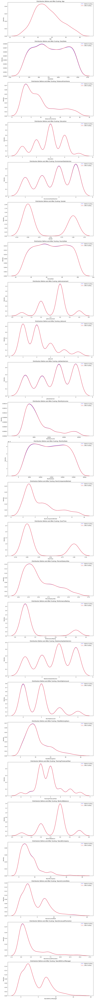

In [23]:
# random imp
plot_before_after_imp(X_train, random_X_train, variable_names)

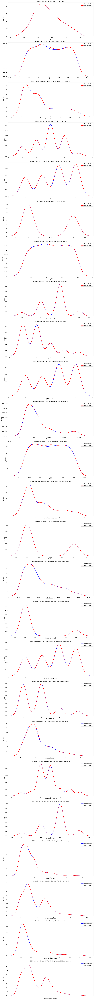

In [24]:
# mean imp
plot_before_after_imp(X_train, mean_X_train, variable_names)

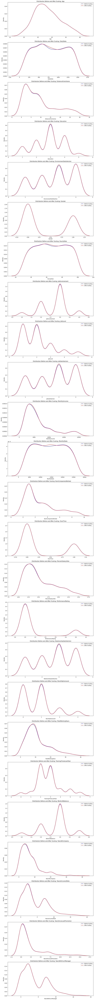

In [25]:
# median imp
plot_before_after_imp(X_train, median_X_train, variable_names)

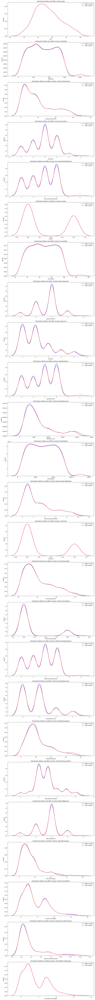

In [26]:
# end-tail imp
plot_before_after_imp(X_train, end_X_train, variable_names)

2.4 Pipeline, ColumnTransformer, find best parameters impute NA values with GridSearchCV

In [27]:
# pipeline for imputation missing values of categorical variables
categorical_pipeline = Pipeline(steps=[
    ('imputer', CategoricalImputer(variables=categorical_feat, imputation_method='frequent')),
    ('onehot', fe_OneHot(variables=categorical_feat))
])

# pipeline for imputation missing values of numerical variables with different methods
numerical_transformers = {
    'random': RandomSampleImputer(variables=numerical_feat, random_state=42),
    'mean': MeanMedianImputer(imputation_method='mean', variables=numerical_feat),
    'median': MeanMedianImputer(imputation_method='median', variables=numerical_feat),
    'endTail': EndTailImputer(imputation_method='gaussian', tail='right', variables=numerical_feat)
}

# ColumnTransformer for concatenate 
preprocessors = {
    name: ColumnTransformer(transformers=[
        ('numerical', transformer, numerical_feat),
        ('categorical', categorical_pipeline, categorical_feat)
    ]) for name, transformer in numerical_transformers.items()
}

# pipeline with different preprocessor
pipelines = {
    name: Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('classifier', RandomForestClassifier(random_state=42))
    ]) for name, preprocessor in preprocessors.items()
}

# find best params with GridSearchCV
param_grid = {
    'random': {
        'preprocessor__numerical__seed': ['general'],
        'preprocessor__numerical__seeding_method': ['add', 'multiply'],
        'classifier__n_estimators': [100, 200, 250]
    },
    'mean': {
        'preprocessor__numerical__imputation_method': ['mean', 'median'],
        'classifier__n_estimators': [100, 200, 250]
    },
    'median': {
        'preprocessor__numerical__imputation_method': ['mean', 'median'],
        'classifier__n_estimators': [100, 200, 250]
    },
    'endTail': {
        'preprocessor__numerical__tail': ['right', 'left'],
        'preprocessor__numerical__imputation_method': ['gaussian', 'iqr', 'max'],
        'preprocessor__numerical__fold': [1.5, 2, 3],
        'classifier__n_estimators': [100, 200, 250]
    }
}
# Create list of all pipelines and parameters for GridSearchCV
all_pipelines = [(name, pipeline) for name, pipeline in pipelines.items()]
all_params = [(name, params) for name, params in param_grid.items()]

# Create GridSearchCV for each pipeline
grid_searches = {
    name: GridSearchCV(estimator=pipeline, param_grid=params, cv=10, n_jobs=-1, error_score='raise')
    for (name, pipeline), (_, params) in zip(all_pipelines, all_params)
}

# train GridSearchCV for each pipeline and results
results = []

for name, grid_search in grid_searches.items():
    print()
    print(f"Running GridSearchCV for {name} pipeline...")
    grid_search.fit(X_train, y_train)
    best_score = grid_search.best_score_
    results.append((name, best_score))
    print()
    print(f"Best Parameters for {name} pipeline:", grid_search.best_params_)
    print()
    
sorted_results = sorted(results, key = lambda x: x[1], reverse = True)

for name, best_score in sorted_results:
    print(f"Best Score for {name} pipeline: {best_score}")



Running GridSearchCV for random pipeline...

Best Parameters for random pipeline: {'classifier__n_estimators': 100, 'preprocessor__numerical__seed': 'general', 'preprocessor__numerical__seeding_method': 'add'}


Running GridSearchCV for mean pipeline...

Best Parameters for mean pipeline: {'classifier__n_estimators': 250, 'preprocessor__numerical__imputation_method': 'mean'}


Running GridSearchCV for median pipeline...

Best Parameters for median pipeline: {'classifier__n_estimators': 250, 'preprocessor__numerical__imputation_method': 'mean'}


Running GridSearchCV for endTail pipeline...

Best Parameters for endTail pipeline: {'classifier__n_estimators': 200, 'preprocessor__numerical__fold': 1.5, 'preprocessor__numerical__imputation_method': 'max', 'preprocessor__numerical__tail': 'right'}

Best Score for endTail pipeline: 0.8566257166257166
Best Score for mean pipeline: 0.8520966420966423
Best Score for median pipeline: 0.8520966420966423
Best Score for random pipeline: 0.852088452

2.5 Temporary pipeline

In [28]:
pipe_mean = Pipeline(steps = [
    ('imp_num', MeanMedianImputer(variables = numerical_feat, imputation_method = 'mean')),
    ('imp_cat', CategoricalImputer(variables = categorical_feat)),
    ('ohe', fe_OneHot(variables = categorical_feat))
])
pipe_mean.fit(X_train)

tmp_mean_train = pipe_mean.transform(X_train)
tmp_mean_test = pipe_mean.transform(X_test)

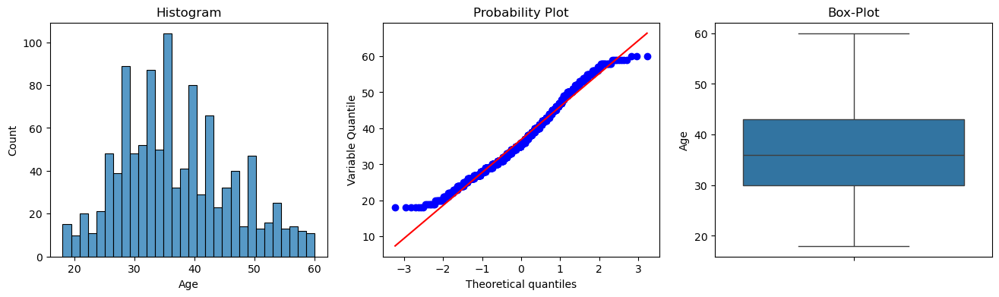

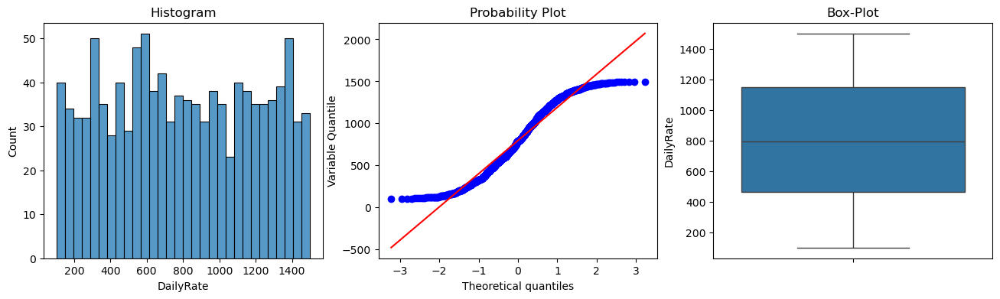

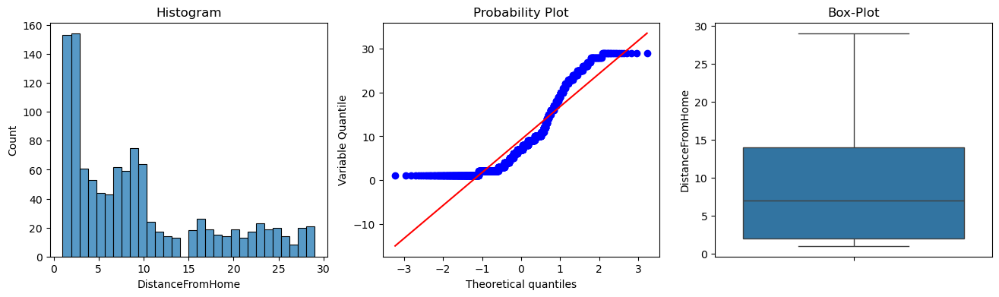

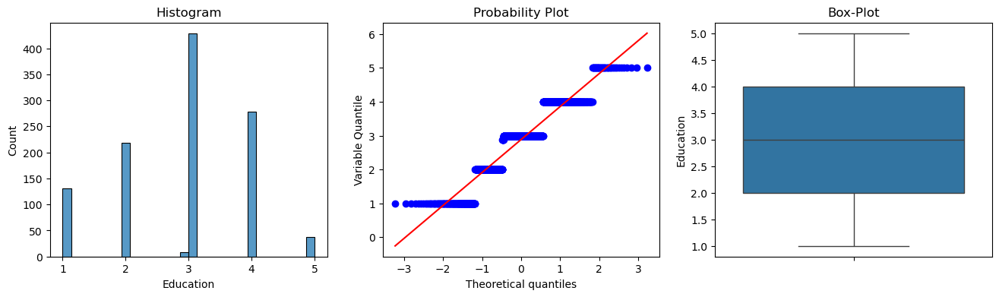

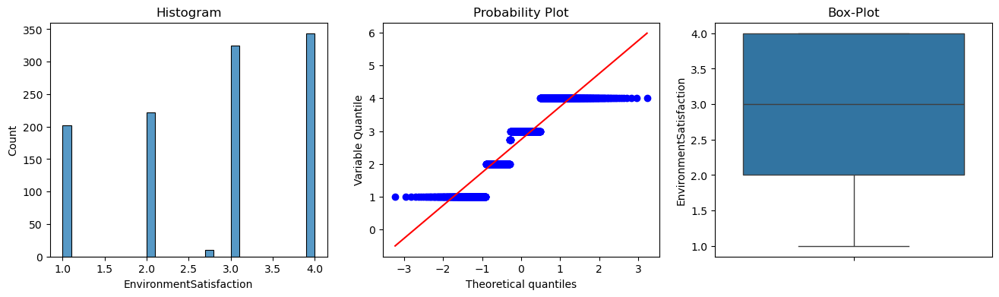

...

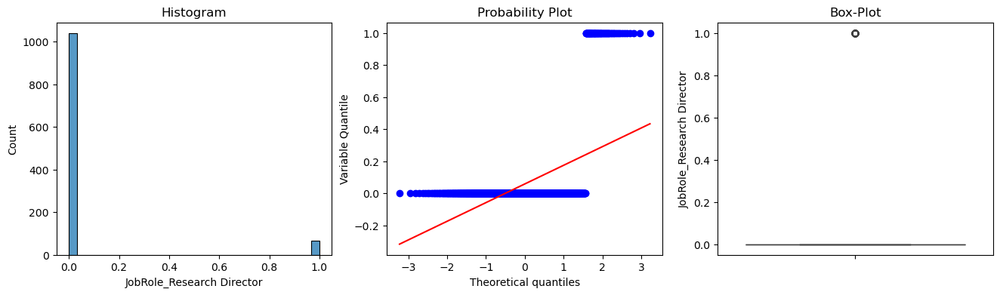

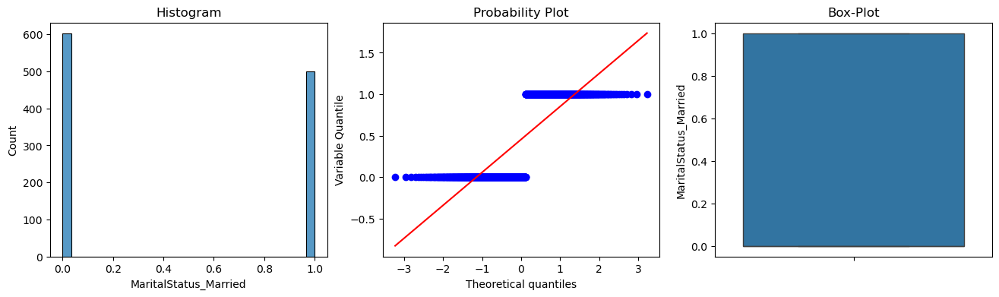

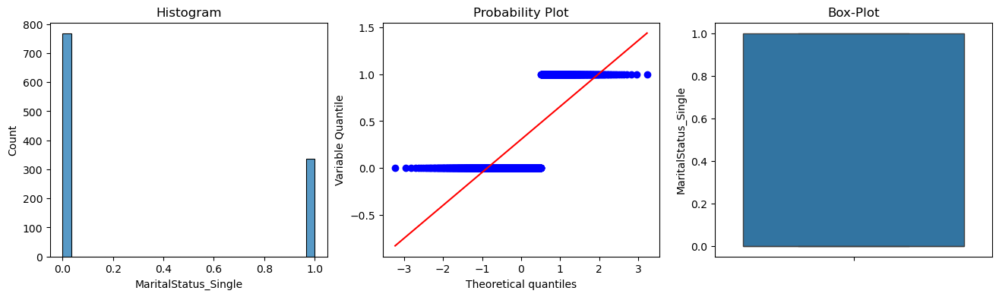

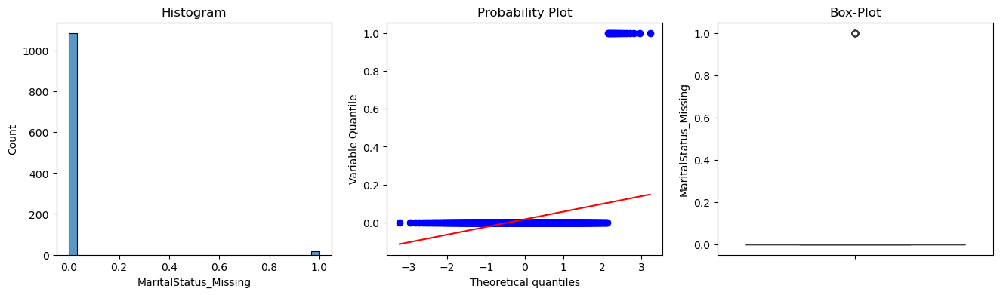

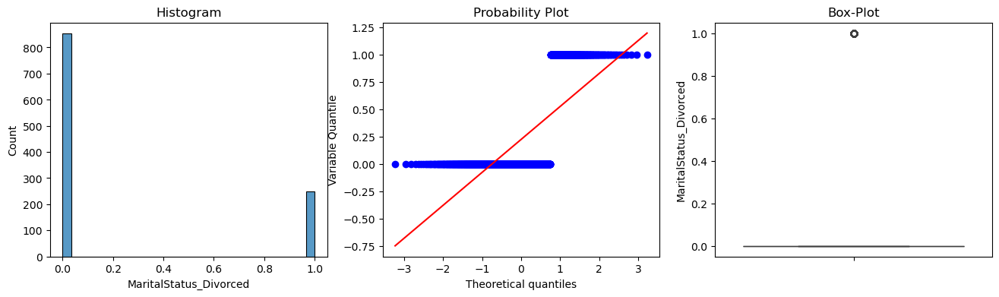

In [29]:
for col in tmp_mean_train.columns:
    diagnostic_plots(tmp_mean_train, col)

2.6 Outliers handling

In [30]:
winsorizer = Winsorizer(
    capping_method = 'gaussian',
    tail = 'both',
    fold = 2,
    variables = continuous
)
winsorizer.fit(tmp_mean_train)

win_train = winsorizer.transform(tmp_mean_train)
win_test = winsorizer.transform(tmp_mean_test)

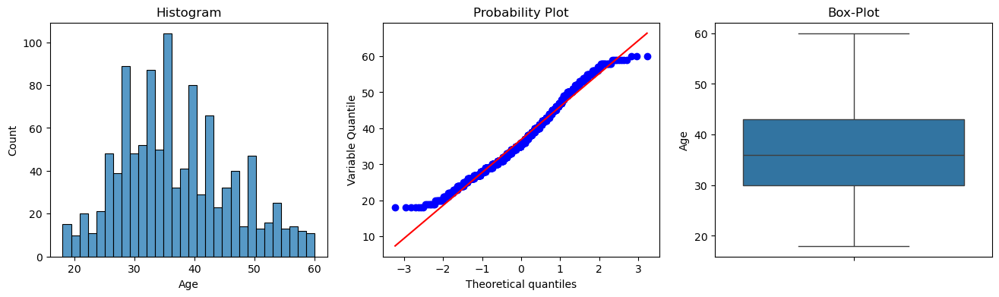

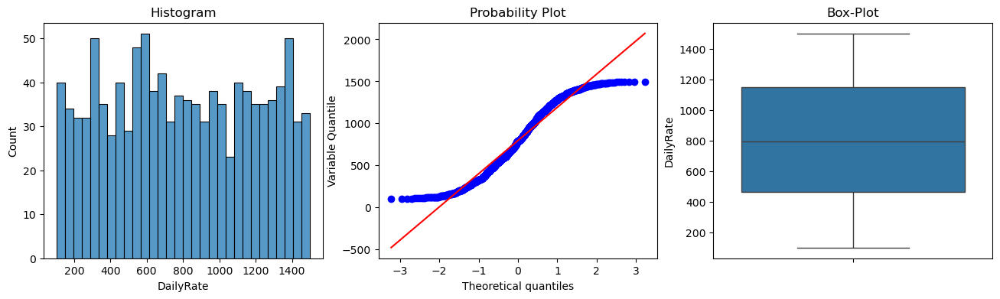

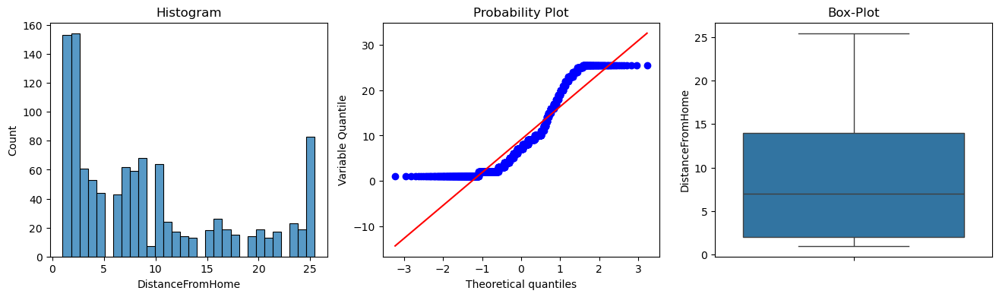

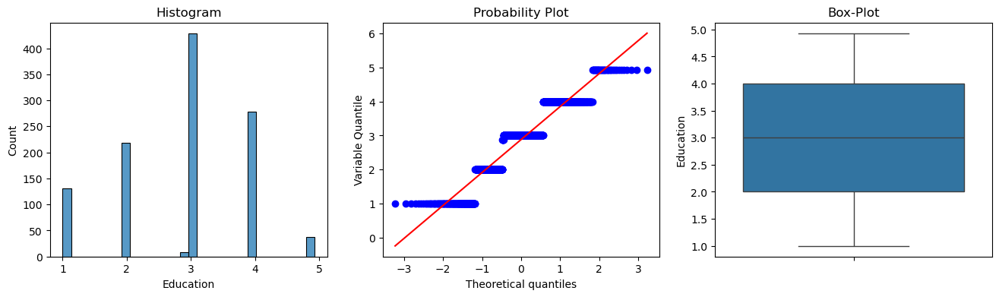

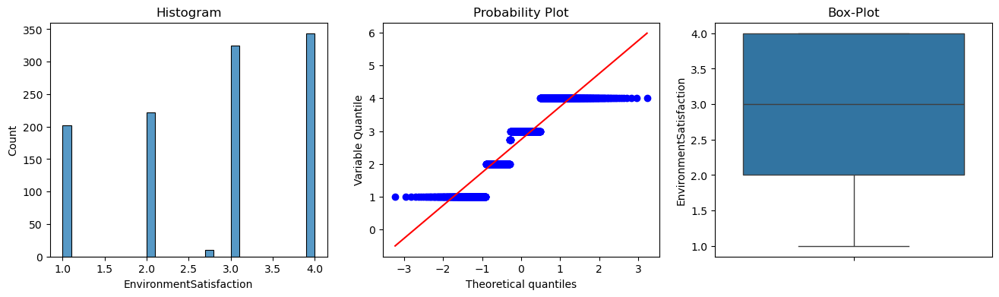

...

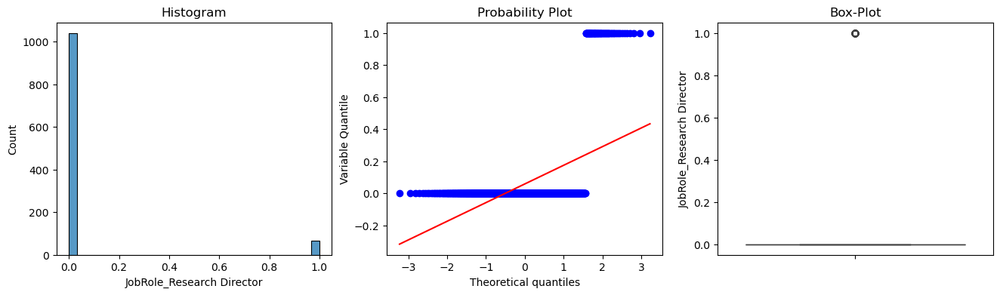

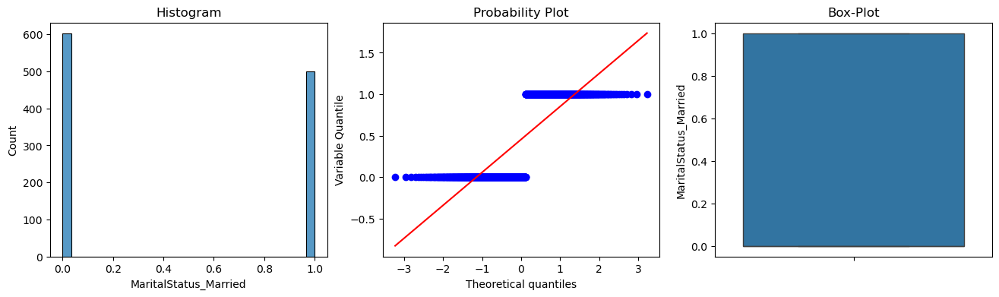

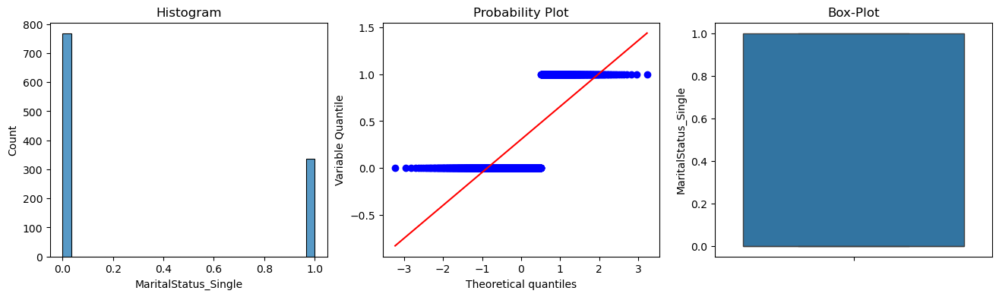

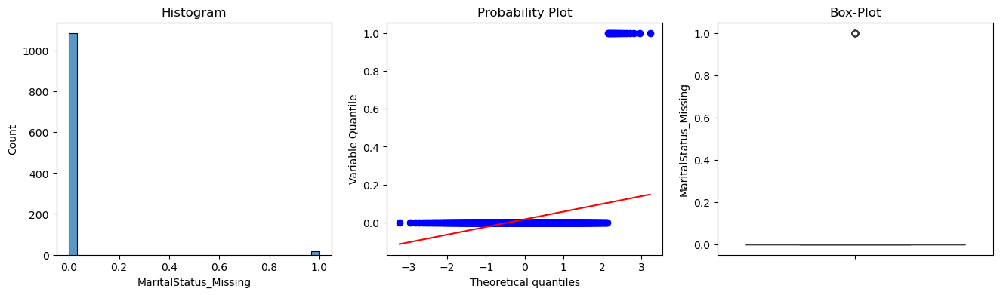

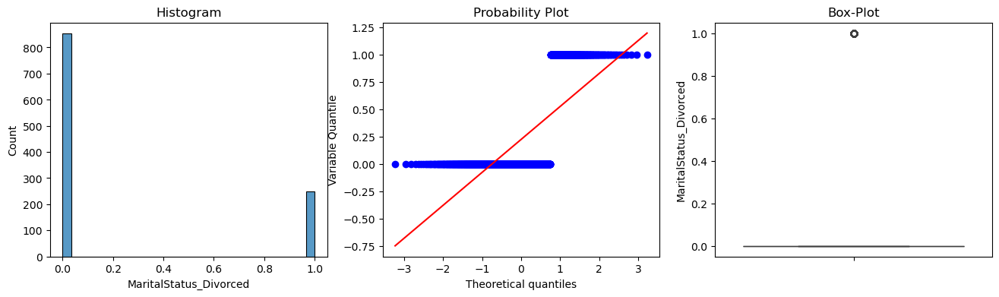

In [31]:
for col in win_train.columns:
    
    diagnostic_plots(win_train, col)

2.7 Discretization with EqualFrequencyDiscretiser

In [32]:
disc = EqualFrequencyDiscretiser(
    q = 10,
    variables = continuous
)
disc.fit(tmp_mean_train)


train_disc = disc.transform(tmp_mean_train)
test_disc = disc.transform(tmp_mean_test)

train_disc.head()

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Travel_Rarely,BusinessTravel_Travel_Frequently,BusinessTravel_Missing,BusinessTravel_Non-Travel,Department_Research & Development,Department_Sales,Department_Human Resources,Department_Missing,EducationField_Life Sciences,EducationField_Medical,EducationField_Marketing,EducationField_Technical Degree,EducationField_Human Resources,EducationField_Missing,EducationField_Other,JobRole_Laboratory Technician,JobRole_Sales Executive,JobRole_Manager,JobRole_Missing,JobRole_Sales Representative,JobRole_Research Scientist,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Manufacturing Director,JobRole_Research Director,MaritalStatus_Married,MaritalStatus_Single,MaritalStatus_Missing,MaritalStatus_Divorced
589,29,5,0,0,0,0,0,0,0,0,0,1,0,1,0,0,3,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0
974,27,4,0,0,2,0,1,0,0,2,5,7,2,0,6,0,0,0,3,1,1,5,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
314,39,0,5,0,1,0,9,1,2,0,9,1,0,1,2,0,3,0,7,1,1,9,5,4,6,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
56,35,5,7,3,0,0,5,1,1,0,7,3,0,0,7,0,3,0,5,1,0,7,5,0,5,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0
1059,35,4,3,0,2,0,6,1,0,1,1,5,0,0,1,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0


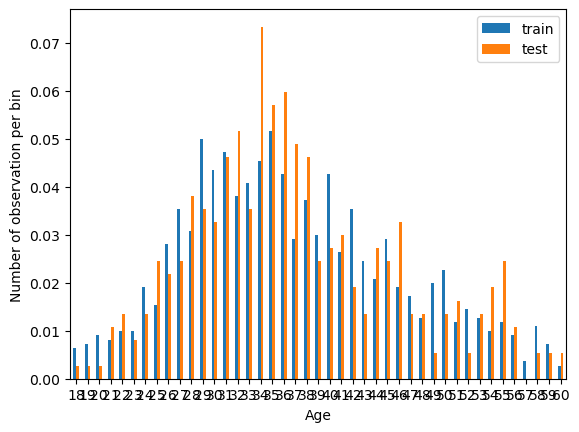

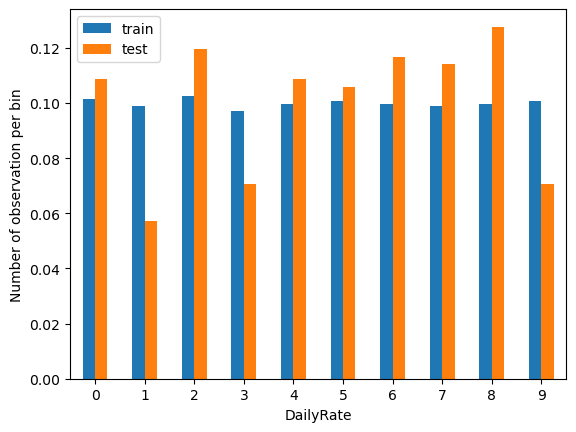

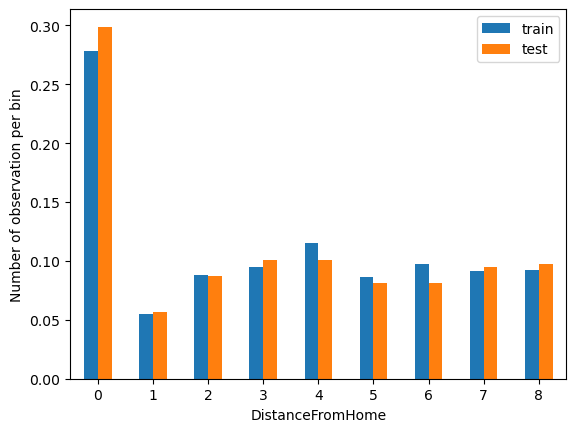

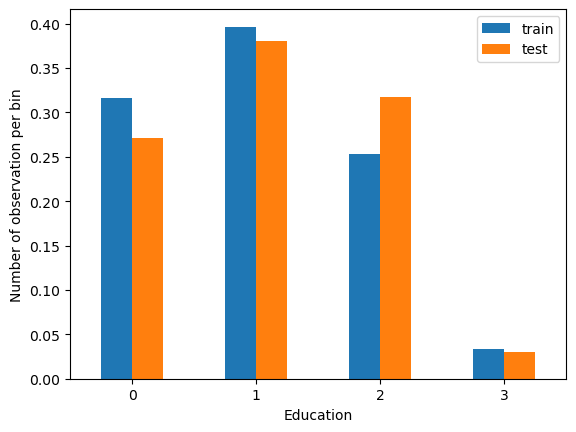

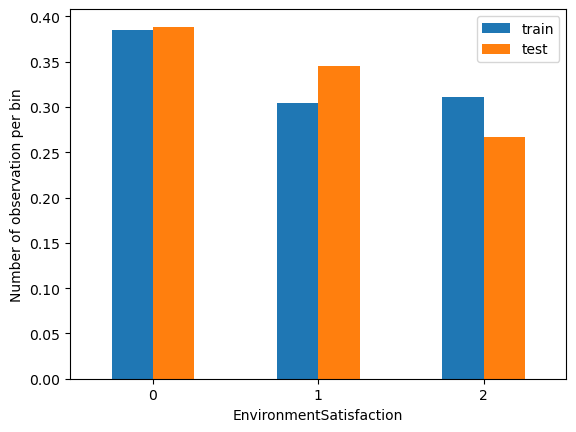

...

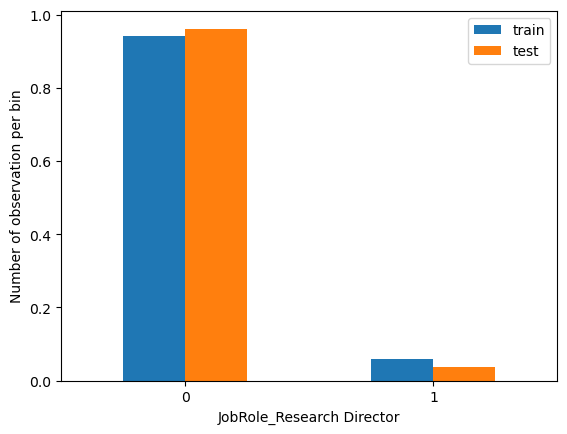

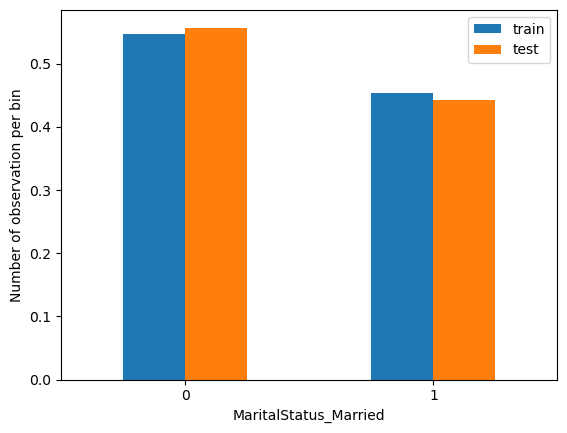

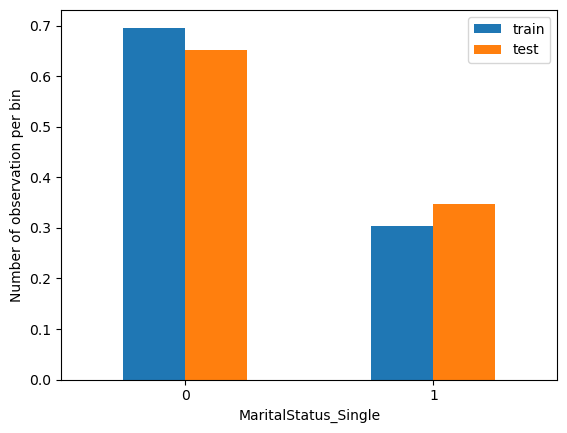

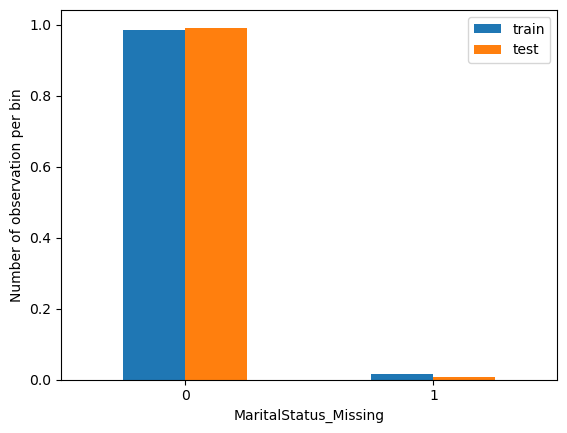

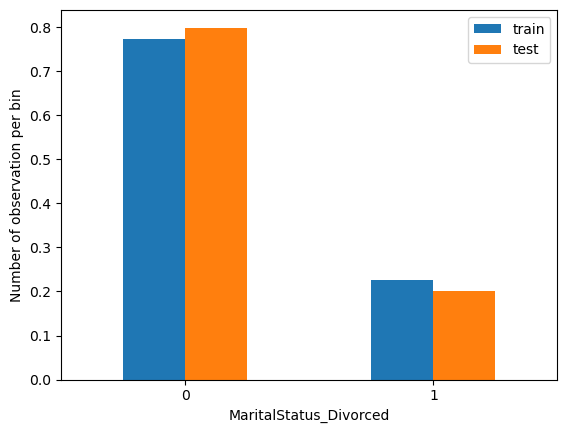

In [33]:
for col in train_disc.columns:
    
    t1 = train_disc.groupby([col])[col].count() / len(train_disc)
    t2 = test_disc.groupby([col])[col].count() / len(test_disc)

    tmp = pd.concat([t1, t2], axis = 1)
    tmp.columns = ['train', 'test']
    tmp.plot.bar()
    plt.xticks(rotation = 0)
    plt.ylabel('Number of observation per bin')
    plt.show()

2.8 Discretization with EqualWidthDiscretiser

In [34]:
disc_width = EqualWidthDiscretiser(
    bins = 10,
    variables = continuous
)
disc_width.fit(tmp_mean_train)

disc_width_train = disc_width.transform(tmp_mean_train)
disc_width_test = disc_width.transform(tmp_mean_test)
disc_width_train.head()

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,MonthlyRate,NumCompaniesWorked,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,BusinessTravel_Travel_Rarely,BusinessTravel_Travel_Frequently,BusinessTravel_Missing,BusinessTravel_Non-Travel,Department_Research & Development,Department_Sales,Department_Human Resources,Department_Missing,EducationField_Life Sciences,EducationField_Medical,EducationField_Marketing,EducationField_Technical Degree,EducationField_Human Resources,EducationField_Missing,EducationField_Other,JobRole_Laboratory Technician,JobRole_Sales Executive,JobRole_Manager,JobRole_Missing,JobRole_Sales Representative,JobRole_Research Scientist,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Manufacturing Director,JobRole_Research Director,MaritalStatus_Married,MaritalStatus_Single,MaritalStatus_Missing,MaritalStatus_Divorced
589,29,5,0,2,3,0,0,3,0,0,0,1,1,1,0,0,9,3,0,1,6,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0
974,27,4,0,0,9,0,1,0,2,9,2,7,3,0,6,9,3,0,1,4,6,1,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
314,39,0,3,0,6,0,9,6,7,0,8,1,1,1,2,0,9,0,5,4,6,5,4,7,5,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
56,35,5,6,9,3,0,5,6,4,0,4,3,1,0,7,9,9,3,2,4,3,2,4,0,4,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0
1059,35,3,2,0,9,0,6,6,0,6,0,5,1,0,1,1,0,3,0,4,6,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0


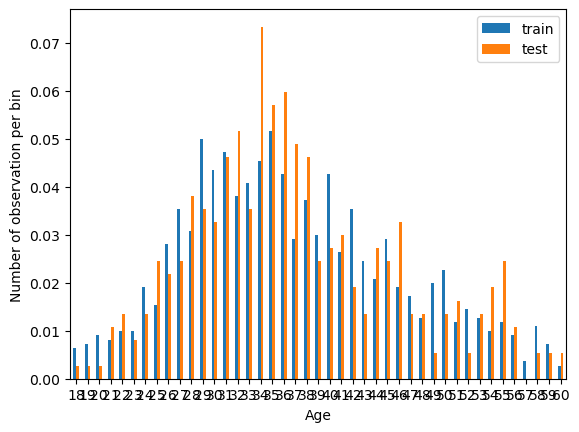

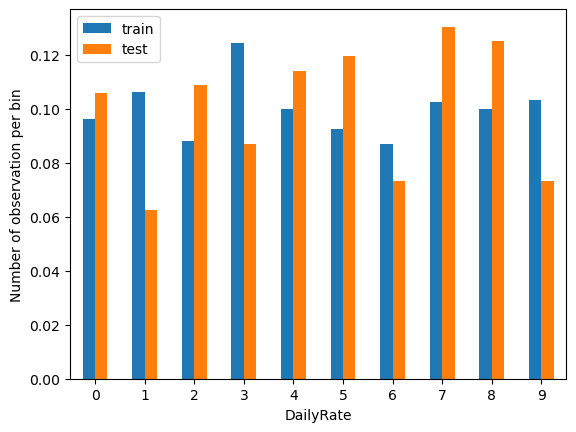

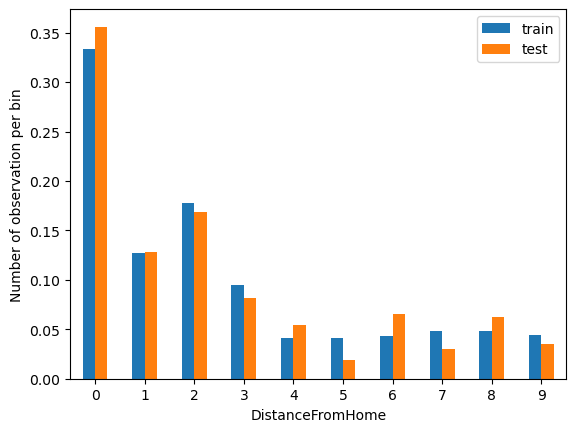

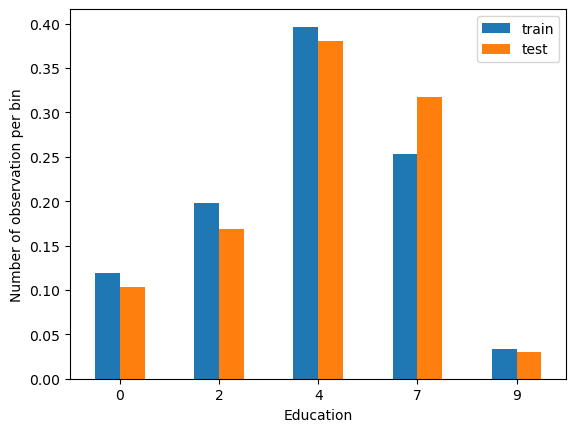

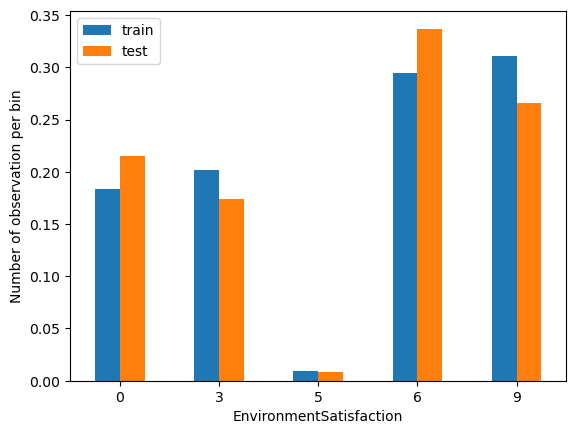

...

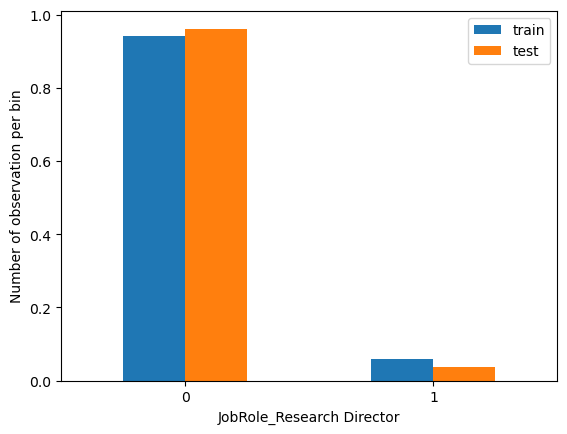

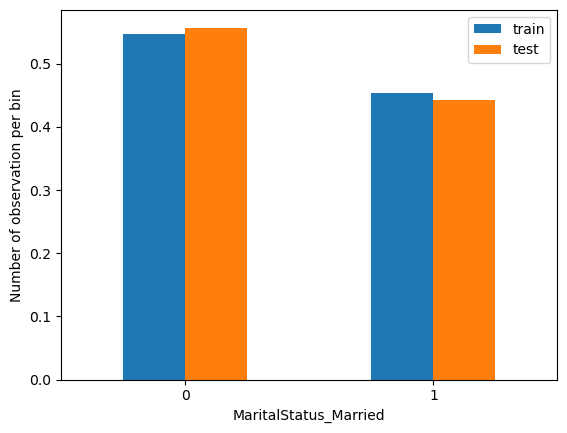

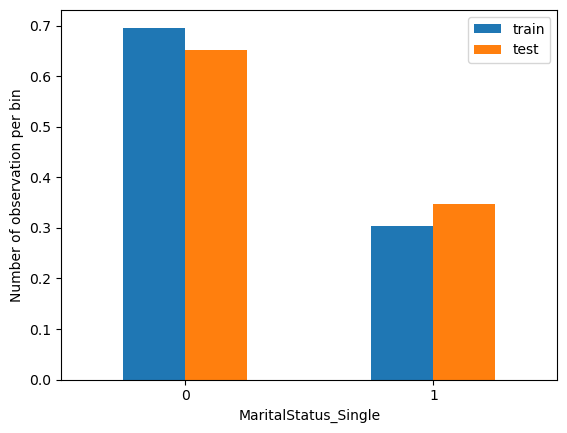

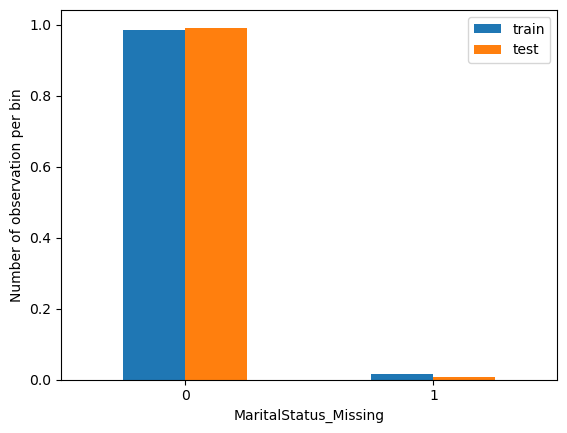

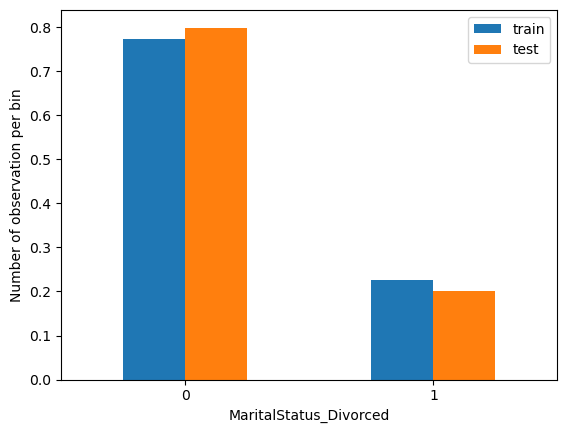

In [35]:
for col in train_disc.columns:
    
    t1 = disc_width_train.groupby([col])[col].count() / len(disc_width_train)
    t2 = disc_width_test.groupby([col])[col].count() / len(disc_width_test)

    tmp = pd.concat([t1, t2], axis = 1)
    tmp.columns = ['train', 'test']
    tmp.plot.bar()
    plt.xticks(rotation = 0)
    plt.ylabel('Number of observation per bin')
    plt.show()

2.9 DecisionTreeDiscretiser

In [36]:
tree_disc = DecisionTreeDiscretiser(
    cv = 10,
    scoring = 'accuracy',
    variables = continuous,
    regression = False,
    param_grid = {
        'max_depth': [2, 3],
        'min_samples_leaf': [4, 6, 8]
    }
)

tree_disc.fit(tmp_mean_train, y_train)

DecisionTreeDiscretiser(cv=10,
                        param_grid={'max_depth': [2, 3],
                                    'min_samples_leaf': [4, 6, 8]},
                        regression=False, scoring='accuracy',
                        variables=['DailyRate', 'DistanceFromHome', 'Education',
                                   'EnvironmentSatisfaction', 'HourlyRate',
                                   'JobInvolvement', 'JobLevel',
                                   'JobSatisfaction', 'MonthlyIncome',
                                   'MonthlyRate', 'NumCompaniesWorked',
                                   'PercentSalaryHike', 'PerformanceRating',
                                   'RelationshipSatisfaction',
                                   'StockOptionLevel', 'TotalWorkingYears',
                                   'TrainingTimesLastYear', 'WorkLifeBalance',
                                   'YearsAtCompany', 'YearsInCurrentRole',
                                   'YearsSinceLastPromotion',
                                   'YearsWithCurrManager'])

In [37]:
train_decision = tree_disc.transform(tmp_mean_train)
test_decision = tree_disc.transform(tmp_mean_test)

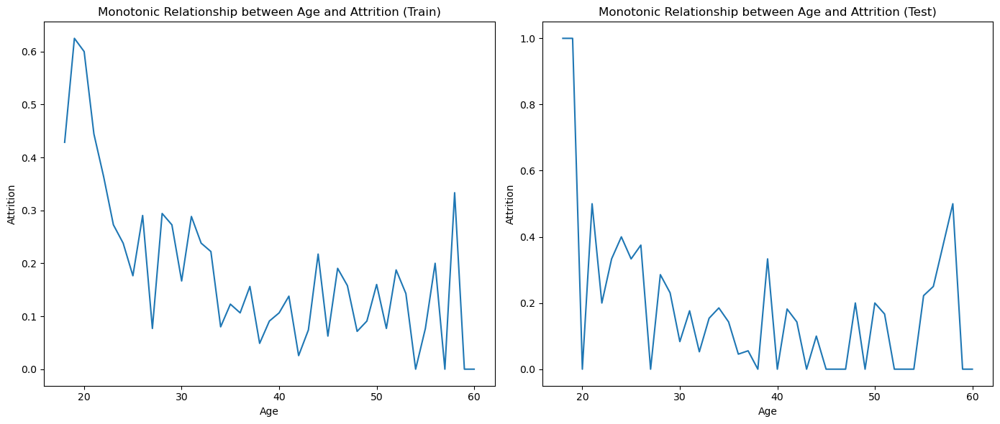

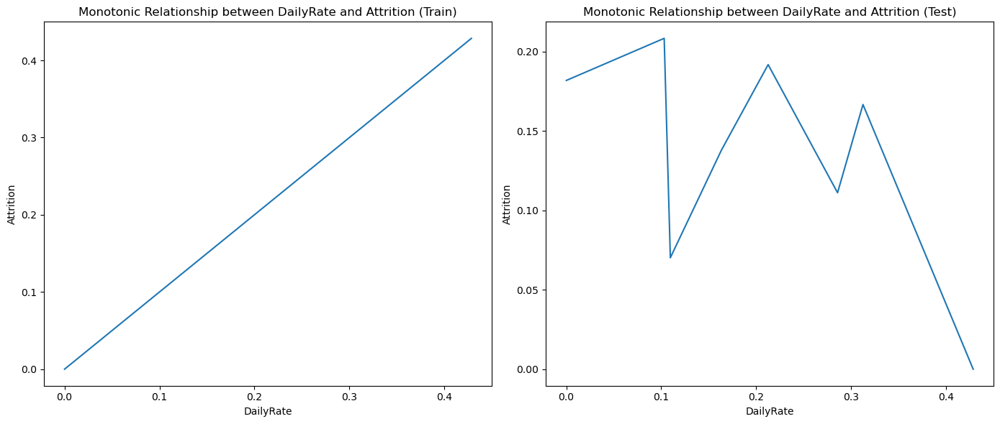

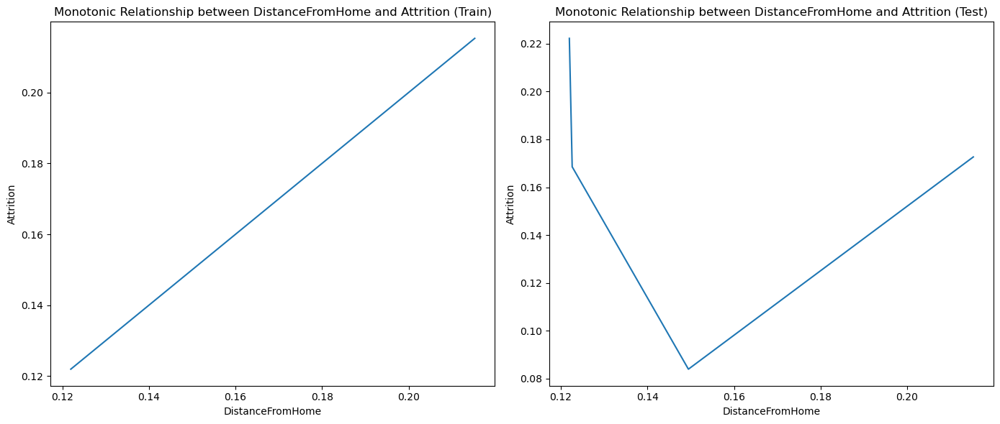

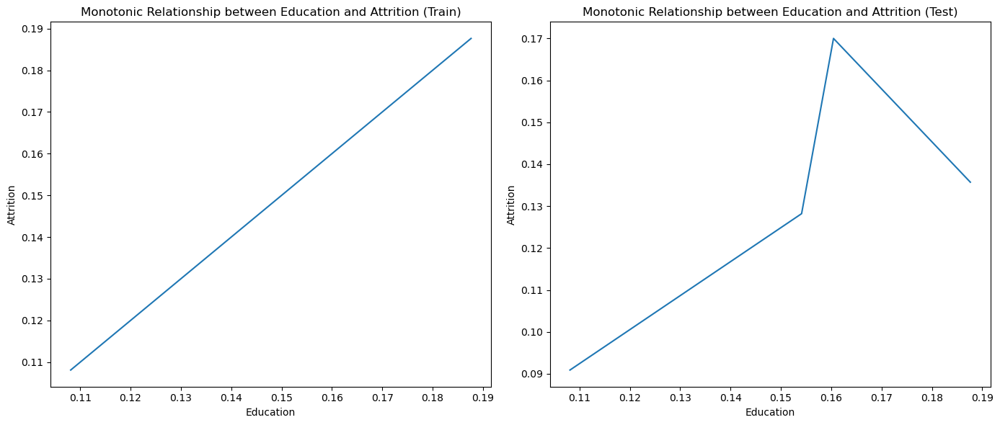

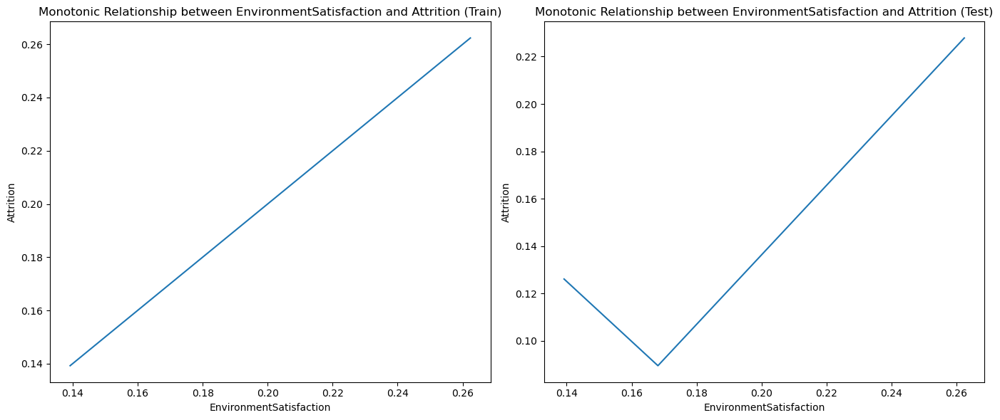

...

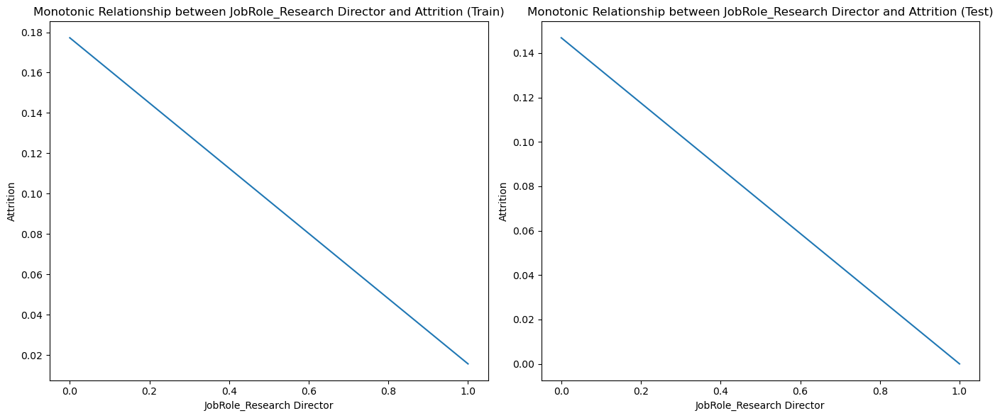

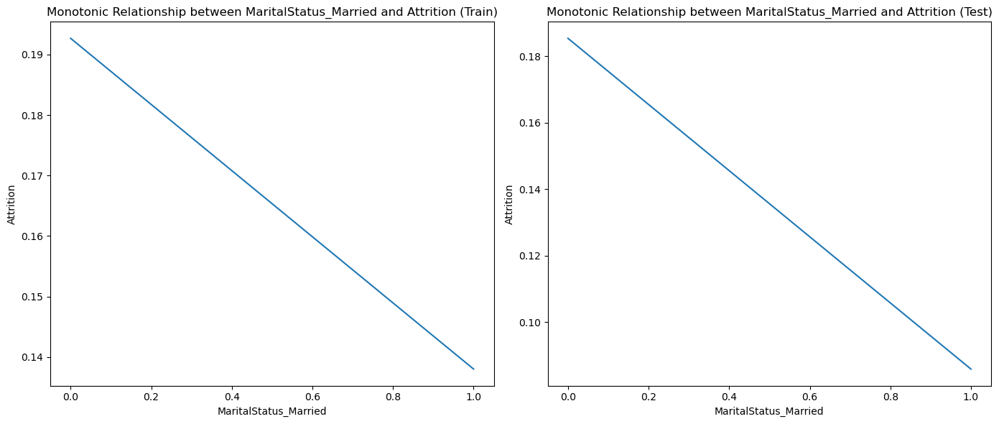

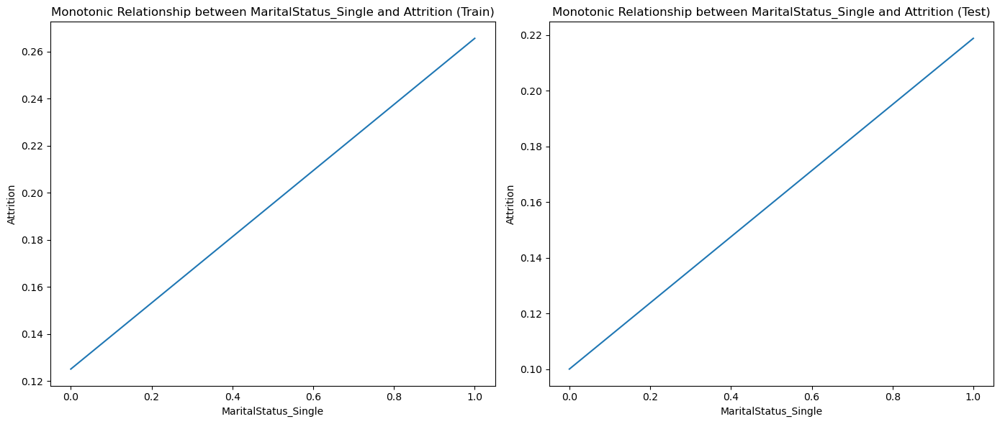

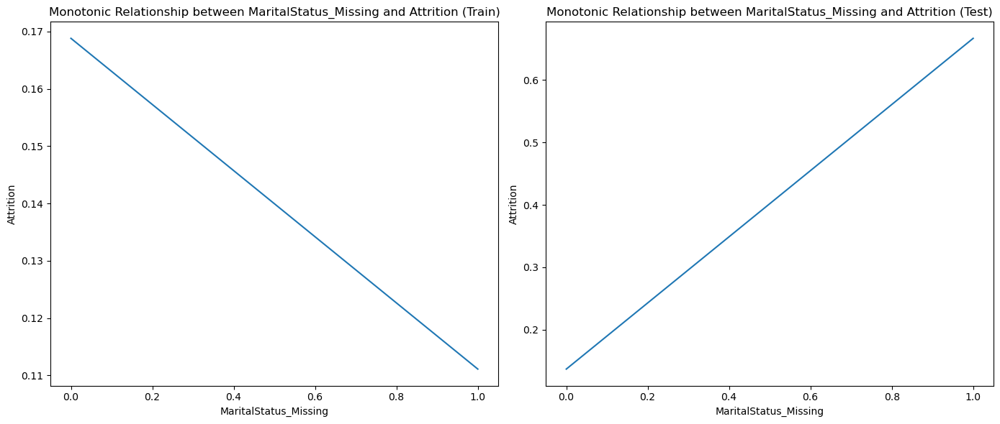

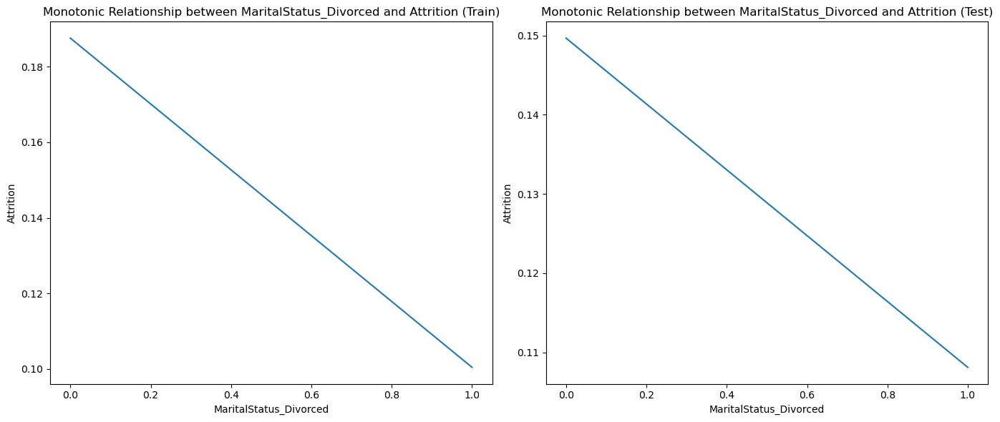

In [38]:
for col in train_decision.columns:
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

    pd.concat([train_decision, y_train], axis=1).groupby([col])['Attrition'].mean().plot(ax=axes[0])
    axes[0].set_title(f'Monotonic Relationship between {col} and Attrition (Train)')
    axes[0].set_ylabel('Attrition')
    axes[0].set_xlabel(col)

    pd.concat([test_decision, y_test], axis=1).groupby([col])['Attrition'].mean().plot(ax=axes[1])
    axes[1].set_title(f'Monotonic Relationship between {col} and Attrition (Test)')
    axes[1].set_ylabel('Attrition')
    axes[1].set_xlabel(col)

    plt.tight_layout()
    plt.show()


3. Training ML Models with default parameters

In [137]:
classifiers = {
    'KNeighbor': KNeighborsClassifier(),
    'RandomForest': RandomForestClassifier(),
    'SVC': SVC(),
    'Decision Tree': DecisionTreeClassifier(),
    'AdaBoost': AdaBoostClassifier(algorithm = 'SAMME'),
    'BaggingClf': BaggingClassifier(),
    'ExtraTreeClf': ExtraTreesClassifier(),
    'XGBoost': XGBClassifier(),
    'GaussianNB': GaussianNB(),
    'SGDC': SGDClassifier(),
}


results = {}  # Dictionary for save results

for name, clf in classifiers.items():
    clf.fit(tmp_mean_train, y_train)
    score = clf.score(tmp_mean_test, y_test)
    results[name] = score

sorted_results = dict(sorted(results.items(), key=lambda item: item[1], reverse=True))

print("\nResults:")
for name, score in sorted_results.items():
    print(f"{name}: {score:.2f}")


Results:
RandomForest: 0.87
SVC: 0.87
AdaBoost: 0.87
ExtraTreeClf: 0.87
SGDC: 0.87
XGBoost: 0.86
KNeighbor: 0.85
BaggingClf: 0.85
GaussianNB: 0.79
Decision Tree: 0.74


In [87]:
def evaluate_performance(model, X_train, y_train, X_test, y_test):
    
    # train model
    model.fit(X_train, y_train)
    
    # predict label
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)
    
    # predict probabilities
    y_pred_proba_train = model.predict_proba(X_train)[:, 1]
    y_pred_proba_test = model.predict_proba(X_test)[:, 1]
    
    # evaluate metrics performance
    roc_auc_train = roc_auc_score(y_train, y_pred_proba_train)
    roc_auc_test = roc_auc_score(y_test, y_pred_proba_test)
    
    accuracy_train = accuracy_score(y_train, y_pred_train)
    accuracy_test = accuracy_score(y_test, y_pred_test)
    
    recall_train = recall_score(y_train, y_pred_train)
    recall_test = recall_score(y_test, y_pred_test)
    
    f1_train = f1_score(y_train, y_pred_train)
    f1_test = f1_score(y_test, y_pred_test)
    
    precision_train = precision_score(y_train, y_pred_train)
    precision_test = precision_score(y_test, y_pred_test)
    
    # Output metrics
    print("ROC AUC Train:", roc_auc_train)
    print("ROC AUC Test:", roc_auc_test)
    print()
    print("Accuracy Train:", accuracy_train)
    print("Accuracy Test:", accuracy_test)
    print()
    print("Recall Train:", recall_train)
    print("Recall Test:", recall_test)
    print()
    print("F1 Score Train:", f1_train)
    print("F1 Score Test:", f1_test)
    print()
    print("Precision Train:", precision_train)
    print("Precision Test:", precision_test)
    print()
    
    # evaluate mean metrics with cross_val_score
    roc_auc_cv_scores = cross_val_score(model, X_train, y_train, cv=10, scoring='roc_auc')
    accuracy_cv_scores = cross_val_score(model, X_train, y_train, cv=10, scoring='accuracy')
    
    roc_auc_cv_mean = roc_auc_cv_scores.mean()
    accuracy_cv_mean = accuracy_cv_scores.mean()
    
    # evaluate Standard Deviation
    roc_auc_cv_std = roc_auc_cv_scores.std()
    accuracy_cv_std = accuracy_cv_scores.std()
    
    # Output mean metrics and standard deviation
    print("ROC AUC (cross-validation): Mean =", roc_auc_cv_mean) 
    print("Accuracy (cross-validation): Mean =", accuracy_cv_mean)
    print()
    print("ROC AUC Std =", roc_auc_cv_std)
    print("Accuracy Std =", accuracy_cv_std)
    print()

    # Confusion Matrix
    print("Confusion Matrix for Train:")
    print(confusion_matrix(y_train, y_pred_train))
    print()
    print("Confusion Matrix for Test:")
    print(confusion_matrix(y_test, y_pred_test))
    print()

3.1 Preprocessing Pipeline for ML models

In [41]:
def build_pipeline(classifier):
    pipeline = Pipeline(steps = [
        ('imputer_cat', CategoricalImputer(variables=categorical_feat, imputation_method='missing')),
        ('imputer_num', MeanMedianImputer(variables=numerical_feat, imputation_method='mean')),
        ('enc', fe_OneHot(variables=categorical_feat)),
        ('outlier', Winsorizer()),
        ('disc', EqualFrequencyDiscretiser(q=7, variables=continuous)),
        ('scaler', MaxAbsScaler()),
        ('clf', classifier)
    ])
    return pipeline

In [42]:
def tune_model(X_train, y_train, classifier, param_grid, cv = 10):
    
    pipeline = build_pipeline(classifier)
    grid_search = GridSearchCV(pipeline, param_grid, cv = cv, n_jobs = -1, scoring = 'accuracy', error_score = 'raise')
    grid_search.fit(X_train, y_train)
    best_model = grid_search.best_estimator_
    best_model.fit(X_train, y_train)
    
    return best_model

In [43]:
def get_best_model(X_train, y_train, classifier, param_grid, cv=10):
    return tune_model(X_train, y_train, classifier, param_grid, cv)

# AdaBoostClassifier

In [44]:
classifier_ADA = AdaBoostClassifier()

param_ADA = {
    'imputer_cat__imputation_method': ['missing', 'frequent'],
    'imputer_num__imputation_method': ['mean', 'median'],
    'outlier__tail': ['right', 'left'],
    'outlier__fold': [1.5, 2, 3],
    'disc__q': [5, 7, 9],
    'scaler': [MinMaxScaler(), MaxAbsScaler()],
    'clf__n_estimators': [50, 100, 150],
    'clf__learning_rate': [0.2, 0.3],
    'clf__algorithm': ['SAMME']
}
best_model_ADA = get_best_model(X_train, y_train, classifier_ADA, param_ADA)

In [45]:
y_pred_Ada_train = best_model_ADA.predict(X_train)
y_pred_Ada_test = best_model_ADA.predict(X_test)

In [88]:
evaluate_performance(best_model_ADA, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.8671318497136739
ROC AUC Test: 0.820101081184825

Accuracy Train: 0.8693284936479129
Accuracy Test: 0.8940217391304348

Recall Train: 0.26063829787234044
Recall Test: 0.24489795918367346

F1 Score Train: 0.4049586776859504
F1 Score Test: 0.38095238095238093

Precision Train: 0.9074074074074074
Precision Test: 0.8571428571428571

ROC AUC (cross-validation): Mean = 0.7874162831828736
Accuracy (cross-validation): Mean = 0.8557248157248157

ROC AUC Std = 0.06077063024697355
Accuracy Std = 0.013635721701693195

Confusion Matrix for Train:
[[909   5]
 [139  49]]

Confusion Matrix for Test:
[[317   2]
 [ 37  12]]



# ExtraTreesClassifier

In [47]:
classifier_Extra = ExtraTreesClassifier()

param_Extra = {
    'imputer_cat__imputation_method': ['missing', 'frequent'],
    'imputer_num__imputation_method': ['mean', 'median'],
    'outlier__tail': ['right', 'left'],
    'outlier__fold': [1.5, 2, 3],
    'disc__q': [5, 7, 9],
    'scaler': [StandardScaler(), MinMaxScaler()],
    'clf__n_estimators': [100, 150, 200],
    'clf__criterion': ['gini', 'entropy'],
    'clf__max_depth': [3, 5]
}
best_model_Extra = get_best_model(X_train, y_train, classifier_Extra, param_Extra)

In [48]:
y_pred_Extra_train = best_model_Extra.predict(X_train)
y_pred_Extra_test = best_model_Extra.predict(X_test)

In [89]:
evaluate_performance(best_model_Extra, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.9129847758275526
ROC AUC Test: 0.7852984453969676

Accuracy Train: 0.8421052631578947
Accuracy Test: 0.8695652173913043

Recall Train: 0.07446808510638298
Recall Test: 0.02040816326530612

F1 Score Train: 0.13861386138613863
F1 Score Test: 0.04

Precision Train: 1.0
Precision Test: 1.0

ROC AUC (cross-validation): Mean = 0.7855718588556116
Accuracy (cross-validation): Mean = 0.8375675675675675

ROC AUC Std = 0.03846509832222986
Accuracy Std = 0.007538994848315637

Confusion Matrix for Train:
[[914   0]
 [174  14]]

Confusion Matrix for Test:
[[319   0]
 [ 48   1]]



# BaggingClassifier

In [50]:
classifier_Bagging = BaggingClassifier()

param_Bagg = {
    'imputer_cat__imputation_method': ['missing', 'frequent'],
    'imputer_num__imputation_method': ['mean', 'median'],
    'outlier__tail': ['right', 'left'],
    'outlier__fold': [1.5, 2, 3],
    'disc__q': [5, 8],
    'scaler': [MaxAbsScaler(), StandardScaler()],
    'clf__n_estimators': [50, 100, 150],
    'clf__max_samples': [0.8, 1],
    'clf__max_features': [0.8, 1]
}
best_model_bagg = get_best_model(X_train, y_train, classifier_Bagging, param_Bagg)

In [51]:
y_pred_Bagg_train = best_model_bagg.predict(X_train)
y_pred_Bagg_test = best_model_bagg.predict(X_test)

In [90]:
evaluate_performance(best_model_bagg, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.9999999999999999
ROC AUC Test: 0.7793167423709296

Accuracy Train: 1.0
Accuracy Test: 0.8777173913043478

Recall Train: 1.0
Recall Test: 0.16326530612244897

F1 Score Train: 1.0
F1 Score Test: 0.26229508196721313

Precision Train: 1.0
Precision Test: 0.6666666666666666

ROC AUC (cross-validation): Mean = 0.7839057649698382
Accuracy (cross-validation): Mean = 0.8502457002457001

ROC AUC Std = 0.05646524771580953
Accuracy Std = 0.01935745296458435

Confusion Matrix for Train:
[[914   0]
 [  0 188]]

Confusion Matrix for Test:
[[315   4]
 [ 41   8]]



# XGBClassifier

In [53]:
classifier_XGB = XGBClassifier()

param_XGB = {
    'imputer_cat__imputation_method': ['missing', 'frequent'],
    'imputer_num__imputation_method': ['mean', 'median'],
    'outlier__tail': ['right', 'left'],
    'outlier__fold': [1.5, 2, 3],
    'disc__q': [5, 8],
    'scaler': [MinMaxScaler(), StandardScaler()],
    'clf__n_estimators': [100, 200, 300],
    'clf__max_depth': [4, 6],
    'clf__learning_rate': [0.2, 0.3]
}

best_model_XGB = get_best_model(X_train, y_train, classifier_XGB, param_XGB)

In [54]:
y_pred_XGB_train = best_model_XGB.predict(X_train)
y_pred_XGB_test = best_model_XGB.predict(X_test)

In [91]:
evaluate_performance(best_model_XGB, X_train, y_train, X_test, y_test)

ROC AUC Train: 1.0
ROC AUC Test: 0.7551020408163265

Accuracy Train: 1.0
Accuracy Test: 0.8722826086956522

Recall Train: 1.0
Recall Test: 0.3673469387755102

F1 Score Train: 1.0
F1 Score Test: 0.43373493975903615

Precision Train: 1.0
Precision Test: 0.5294117647058824

ROC AUC (cross-validation): Mean = 0.7774677077308656
Accuracy (cross-validation): Mean = 0.8521539721539722

ROC AUC Std = 0.055619073204746905
Accuracy Std = 0.023185009114045176

Confusion Matrix for Train:
[[914   0]
 [  0 188]]

Confusion Matrix for Test:
[[303  16]
 [ 31  18]]



# RandomForestClassifier

In [56]:
classifier_RF = RandomForestClassifier()

param_RF = {
    'imputer_cat__imputation_method': ['missing', 'frequent'],
    'imputer_num__imputation_method': ['mean', 'median'],
    'outlier__tail': ['right', 'left'],
    'outlier__fold': [1.5, 2, 3],
    'disc__q': [5, 8],
    'scaler': [MaxAbsScaler(), StandardScaler()],
    'clf__n_estimators': [100, 200, 300],
    'clf__criterion': ['gini', 'entropy'],
    'clf__max_depth': [4, 6]
}
best_model_RF = get_best_model(X_train, y_train, classifier_RF, param_RF)

In [57]:
y_pred_RF_train = best_model_RF.predict(X_train)
y_pred_RF_test = best_model_RF.predict(X_test)

In [92]:
evaluate_performance(best_model_RF, X_train, y_train, X_test, y_test)

ROC AUC Train: 0.9687485450905535
ROC AUC Test: 0.7998208687863859

Accuracy Train: 0.867513611615245
Accuracy Test: 0.875

Recall Train: 0.22340425531914893
Recall Test: 0.08163265306122448

F1 Score Train: 0.3652173913043478
F1 Score Test: 0.14814814814814814

Precision Train: 1.0
Precision Test: 0.8

ROC AUC (cross-validation): Mean = 0.7831731642372375
Accuracy (cross-validation): Mean = 0.8402948402948404

ROC AUC Std = 0.04101038135172348
Accuracy Std = 0.009157366783778454

Confusion Matrix for Train:
[[914   0]
 [146  42]]

Confusion Matrix for Test:
[[318   1]
 [ 45   4]]



In [93]:
y_pred_Ada_test = (y_pred_Ada_test > 0.5)
y_pred_Ada_train = (y_pred_Ada_train > 0.5)

y_pred_Bagg_test = (y_pred_Bagg_test > 0.5)
y_pred_Bagg_train = (y_pred_Bagg_train > 0.5)

y_pred_Extra_test = (y_pred_Extra_test > 0.5)
y_pred_Extra_train = (y_pred_Extra_train > 0.5)

y_pred_RF_test = (y_pred_RF_test > 0.5)
y_pred_RF_train = (y_pred_RF_train > 0.5)

y_pred_XGB_test = (y_pred_XGB_test > 0.5)
y_pred_XGB_train = (y_pred_XGB_train > 0.5)

3.2 Separate for training and test split to train ANN 

In [60]:
X_train, X_test, y_train, y_test = train_test_split(
    dataset.drop(labels = ['Attrition'], axis = 1),
    dataset['Attrition'],
    test_size = 0.25
)
X_train.shape, X_test.shape

((1102, 30), (368, 30))

In [61]:
# Function for demonstrate model performance
def plot_performance(history):
    plt.figure(figsize=(12, 6))

    # Loss
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss')
    plt.legend()

    # Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Accuracy')
    plt.legend()

    plt.show()

3.3 Preprocessing Pipeline for ANN

In [62]:
# pipeline for ANN 
pipe_preprocessing = Pipeline(steps = [
    ('imputer_cat', CategoricalImputer(variables = categorical_feat, imputation_method = 'missing')),
    ('imputer_num', MeanMedianImputer(variables = numerical_feat, imputation_method = 'mean')),
    ('enc', fe_OneHot(variables = categorical_feat)),
    ('outlier', Winsorizer()),
    ('disc', EqualFrequencyDiscretiser(q = 7, variables = continuous)),
    ('scaler', MaxAbsScaler())
])
X_train_preprocessed = pipe_preprocessing.fit_transform(X_train)
X_test_preprocessed = pipe_preprocessing.transform(X_test)

3.4 Early stopping

In [63]:
early_stopping = EarlyStopping(
    monitor = 'val_accuracy',
    min_delta = 0.001,
    patience = 50,
    restore_best_weights = True,
    verbose = 1,
    mode = 'auto'
)
callbacks = early_stopping

3.5 Build the ANN 

In [64]:
input_shape = (X_train_preprocessed.shape[1],)

def create_model(optimizer = 'adam'):
    classifier = Sequential()

    classifier.add(Input(shape = input_shape))
    
    classifier.add(Dense(units = 300, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.2))

    classifier.add(Dense(units = 300, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.2))

    classifier.add(Dense(units = 250, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.3))

    classifier.add(Dense(units = 200, kernel_initializer = 'he_uniform', activation = 'relu', kernel_regularizer = l2(0.001)))
    classifier.add(BatchNormalization())
    classifier.add(Dropout(0.2))

    classifier.add(Dense(units = 1, activation = 'sigmoid', kernel_initializer = 'glorot_uniform'))
    classifier.compile(optimizer = optimizer, loss = 'binary_crossentropy', metrics = ['accuracy'])
    return classifier

hist_model = create_model()
history1 = hist_model.fit(
    X_train_preprocessed,
    y_train,
    epochs = 300,
    batch_size = 128,
    validation_split = 0.2,
    callbacks = callbacks
)
hist_model.summary()

Epoch 1/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5459 - loss: 2.9385 - val_accuracy: 0.3756 - val_loss: 2.8509
Epoch 2/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.6421 - loss: 2.7682 - val_accuracy: 0.4977 - val_loss: 2.7744
Epoch 3/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.6988 - loss: 2.6816 - val_accuracy: 0.6652 - val_loss: 2.6717
Epoch 4/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7505 - loss: 2.5556 - val_accuracy: 0.8190 - val_loss: 2.5821
Epoch 5/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7862 - loss: 2.4874 - val_accuracy: 0.8326 - val_loss: 2.5222
Epoch 6/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.7910 - loss: 2.4427 - val_accuracy: 0.8281 - val_loss: 2.4771
Epoch 7/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8414 - loss: 2.3918 - val_accuracy: 0.8235 - val_loss: 2.4363
Epoch 8/300
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8401 - loss: 2.3692 - val_accuracy: 0.8190 - val_loss: 2.405

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 300)            │        16,500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 300)            │         1,200 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 300)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 300)            │        90,300 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 300)            │         1,200 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 300)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 250)            │        75,250 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 250)            │         1,000 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 250)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 200)            │        50,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 200)            │           800 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 200)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 1)              │           201 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 705,755 (2.69 MB)

 Trainable params: 234,551 (916.21 KB)

 Non-trainable params: 2,100 (8.20 KB)

 Optimizer params: 469,104 (1.79 MB)

In [65]:
y_pred_ann_train = hist_model.predict(X_train_preprocessed)
y_pred_ann_test = hist_model.predict(X_test_preprocessed)

35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 858us/step


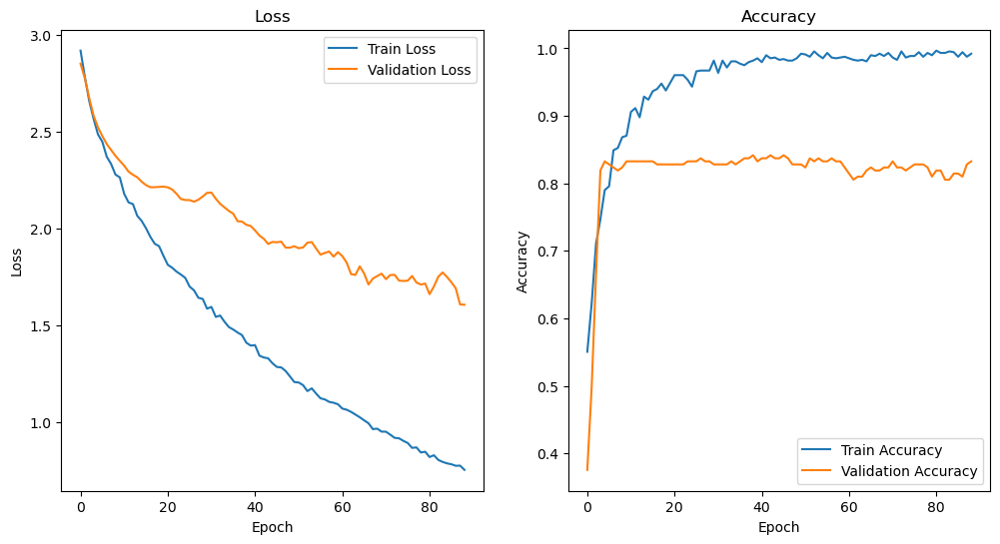

In [66]:
plot_performance(history1)

3.6 GridSearchCV

In [73]:
pipeline = Pipeline(steps=[
    ('preprocessing', pipe_preprocessing),
    ('model', KerasClassifier(model=create_model, 
                              epochs = 100,
                              batch_size = 128,
                              optimizer = 'adam',
                              metrics=['val_accuracy'],
                              validation_split = 0.2,
                              callbacks = callbacks
                             ))
])

# GridSearch parametrs
parameters = {
    'model__batch_size': [64, 128, 256],
    'model__epochs': [100, 200, 250],
    'model__optimizer': ['adam', 'SGD']
}

grid = GridSearchCV(
    estimator = pipeline,
    param_grid = parameters,
    n_jobs = -1,
    cv = 3,
    error_score = 'raise'
)

grid_results = grid.fit(X_train, y_train, model__validation_split = 0.2, model__callbacks = callbacks)

best_model = grid_results.best_estimator_
print("Best Parameters:", grid_results.best_params_)

Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/200
Epoch 1/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - accuracy: 0.5462 - loss: 2.9903 - val_accuracy: 0.7891 - val_loss: 2.6012
Epoch 2/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - accuracy: 0.5048 - loss: 3.0564 - val_accuracy: 0.7959 - val_loss: 2.6446
Epoch 2/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6320 - loss: 2.7249 - val_accuracy: 0.8027 - val_loss: 2.6278
Epoch 3/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6390 - loss: 2.7872 - val_accuracy: 0.8027 - val_loss: 2.5663
Epoch 3/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6985 - loss: 2.6835 - val_accuracy: 0.8299 - val_loss: 2.5188
Epoch 4/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.6521 - loss: 2.7008 - val_accuracy: 0.8435 - val_loss: 2.5602
Epoch 4/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - accuracy: 0.5509 - loss: 2.9848 - val_accuracy: 0.8435 - val_loss: 2.5953
Epoch 2/100
10/10 ━━━━━

In [74]:
best_params = grid_results.best_params_
print('Best Parameters:', best_params)

Best Parameters: {'model__batch_size': 128, 'model__epochs': 250, 'model__optimizer': 'adam'}


In [75]:
best_model = create_model(optimizer = best_params['model__optimizer'])

history = best_model.fit(X_train_preprocessed, y_train,
                        validation_split = 0.2,
                        batch_size = best_params['model__batch_size'],
                        epochs = best_params['model__epochs'],
                        callbacks = [EarlyStopping(monitor = 'val_loss', patience = 10, verbose = 1)])

Epoch 1/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5462 - loss: 2.9155 - val_accuracy: 0.7692 - val_loss: 2.6544
Epoch 2/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6155 - loss: 2.8085 - val_accuracy: 0.8190 - val_loss: 2.5811
Epoch 3/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6669 - loss: 2.7028 - val_accuracy: 0.8281 - val_loss: 2.5597
Epoch 4/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7664 - loss: 2.5565 - val_accuracy: 0.8326 - val_loss: 2.5409
Epoch 5/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7418 - loss: 2.5408 - val_accuracy: 0.8326 - val_loss: 2.4998
Epoch 6/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7911 - loss: 2.4638 - val_accuracy: 0.8326 - val_loss: 2.4569
Epoch 7/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8017 - loss: 2.4578 - val_accuracy: 0.8281 - val_loss: 2.4331
Epoch 8/250
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8612 - loss: 2.3387 - val_accuracy: 0.8281 - val_loss: 2.4015

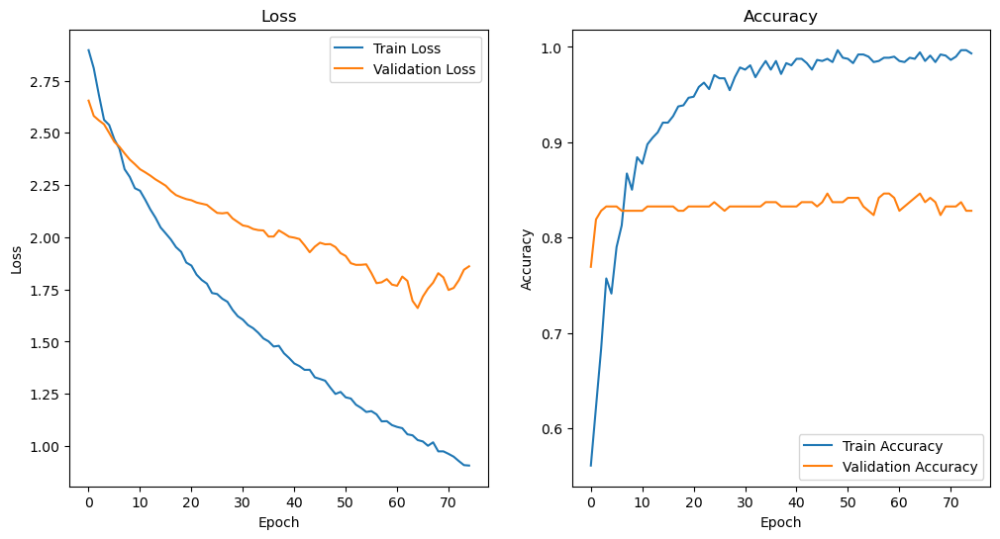

In [77]:
plot_performance(history)

In [78]:
y_pred_ann_train = best_model.predict(X_train_preprocessed)
y_pred_ann_test = best_model.predict(X_test_preprocessed)

y_pred_ann_train = (y_pred_ann_train > 0.5)
y_pred_ann_test = (y_pred_ann_test > 0.5)

35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 752us/step


4. Results

In [108]:
models = {
    'Ada Boost': best_model_ADA,
    'BaggingClf': best_model_bagg,
    'ExtraTreeClf': best_model_Extra,
    'Random Forest': best_model_RF,
    'XGBoostClf': best_model_XGB
}

In [132]:
# Results all metrics in Data Frame
def calculate_performance_metrics(models, X_train, y_train, X_test, y_test, model_names):
    metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC']
    metric_scores = {metric: [] for metric in metrics}

    for model_name, model in models.items():  # iterate through model names and corresponding models
        train_predictions = model.predict(X_train)
        test_predictions = model.predict(X_test)

        accuracy = accuracy_score(y_test, test_predictions)
        precision = precision_score(y_test, test_predictions)
        recall = recall_score(y_test, test_predictions)
        f1 = f1_score(y_test, test_predictions)
        roc_auc = roc_auc_score(y_test, test_predictions)

        metric_scores['Accuracy'].append(accuracy)
        metric_scores['Precision'].append(precision)
        metric_scores['Recall'].append(recall)
        metric_scores['F1 Score'].append(f1)
        metric_scores['ROC AUC'].append(roc_auc)

    return pd.DataFrame(metric_scores, index=model_names).sort_values(by='Accuracy', ascending=False)

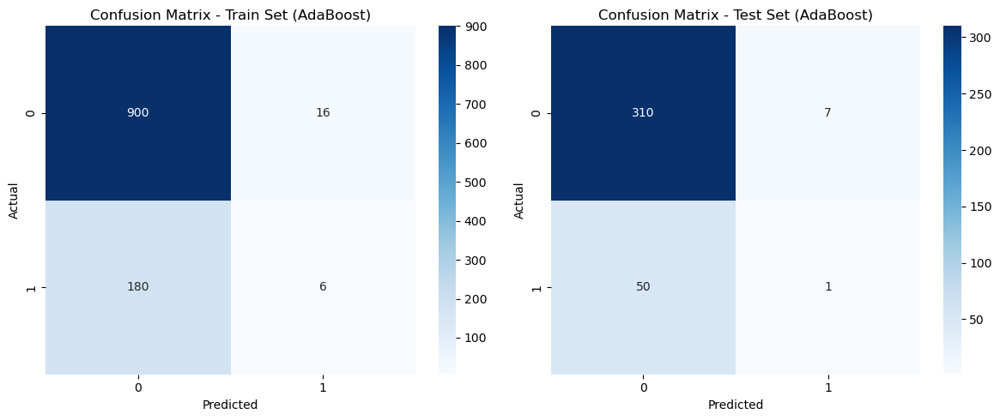

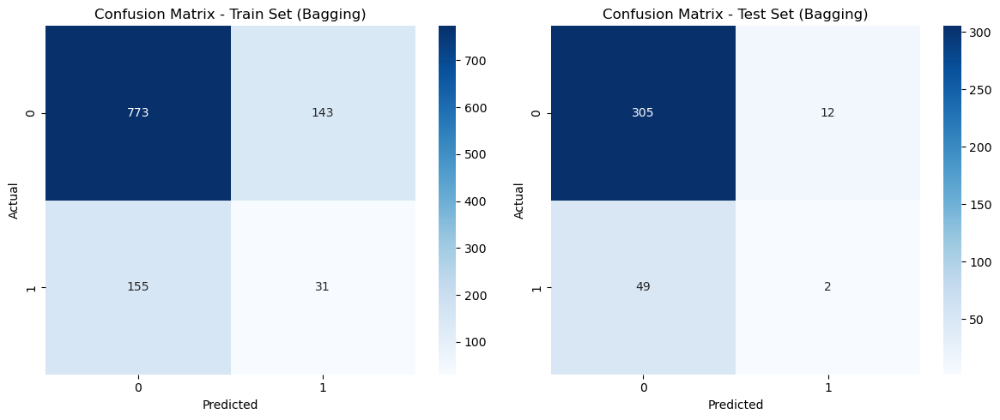

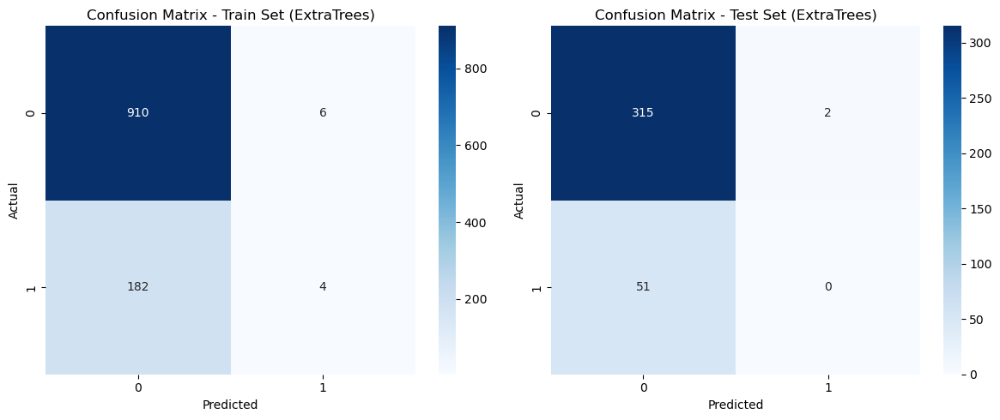

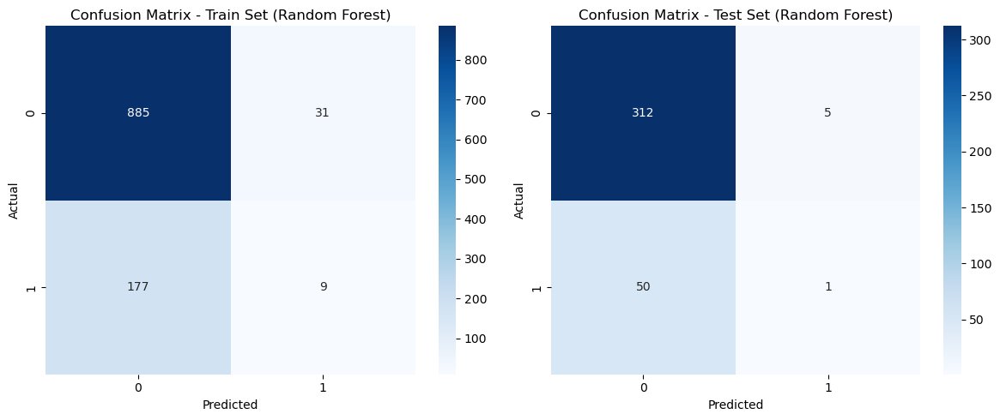

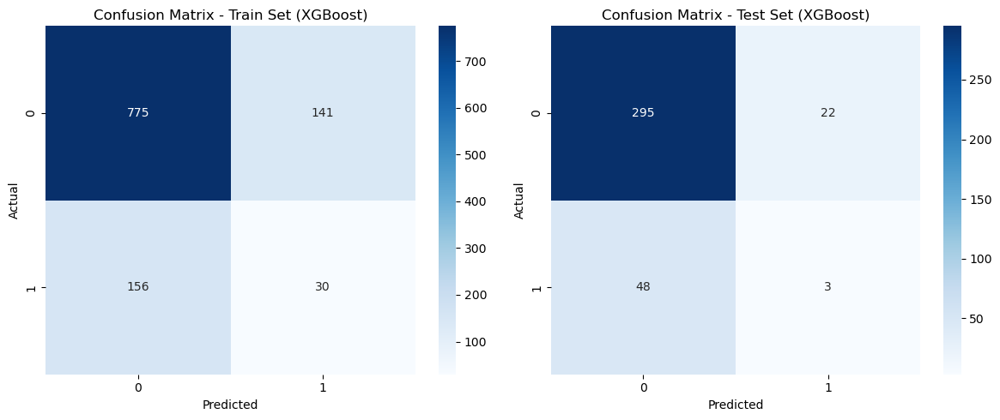

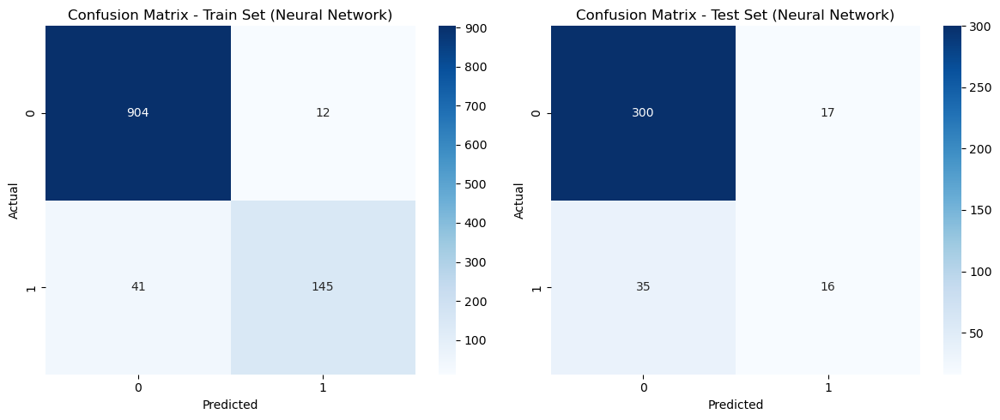

In [74]:
# Confusion matrix
def plot_cm(y_train, y_test, y_train_pred, y_test_pred, model_name):
    # Creating subgraphs for confusion matrix for train and test set
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))

    # Confusion Matrix for train set
    train_cm = confusion_matrix(y_train, y_train_pred)
    sns.heatmap(train_cm, annot=True, cmap='Blues', fmt='d', ax=axes[0])
    axes[0].set_title('Confusion Matrix - Train Set ({})'.format(model_name))
    axes[0].set_xlabel('Predicted')
    axes[0].set_ylabel('Actual')

    # Confusion Matrix for test set
    test_cm = confusion_matrix(y_test, y_test_pred)
    sns.heatmap(test_cm, annot=True, cmap='Blues', fmt='d', ax=axes[1])
    axes[1].set_title('Confusion Matrix - Test Set ({})'.format(model_name))
    axes[1].set_xlabel('Predicted')
    axes[1].set_ylabel('Actual')

    plt.tight_layout()
    plt.show()

# Define model names and corresponding predictions
model_names = ['AdaBoost', 'Bagging', 'ExtraTrees', 'Random Forest', 'XGBoost', 'Neural Network']
y_pred_train = [y_pred_Ada_train, y_pred_Bagg_train, y_pred_Extra_train, y_pred_RF_train, y_pred_XGB_train, y_pred_ann_train]
y_pred_test = [y_pred_Ada_test, y_pred_Bagg_test, y_pred_Extra_test, y_pred_RF_test, y_pred_XGB_test, y_pred_ann_test]

# Build confusion matrix for each model
for y_train_pred, y_test_pred, model_name in zip(y_pred_train, y_pred_test, model_names):
    plot_cm(y_train, y_test, y_train_pred, y_test_pred, model_name)

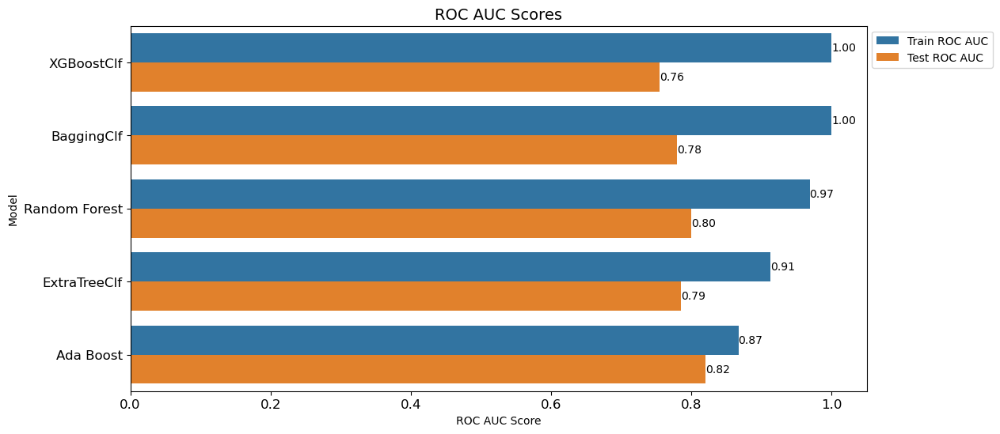

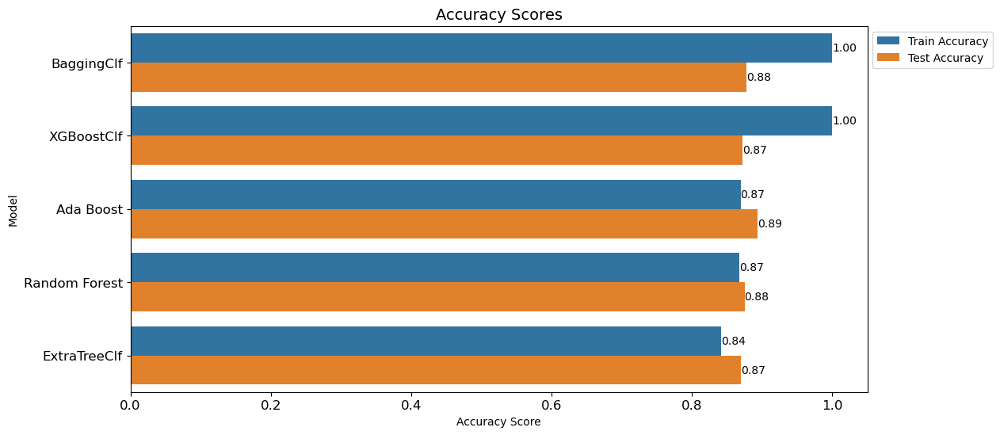

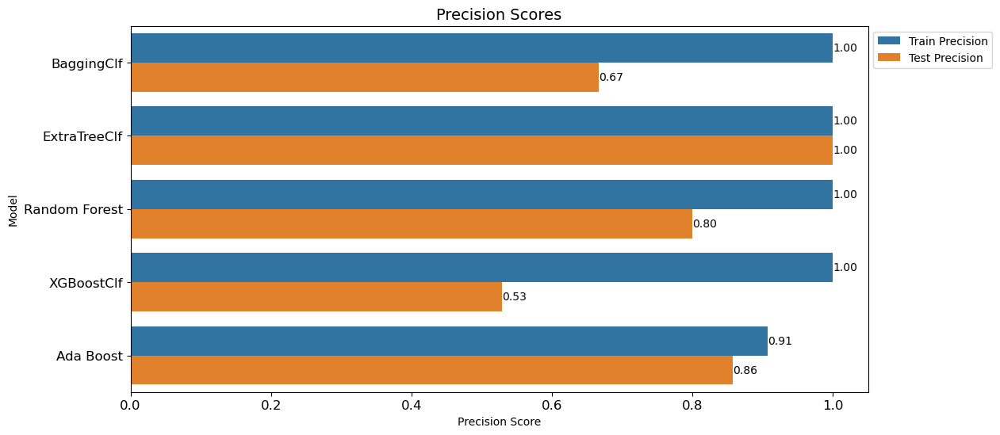

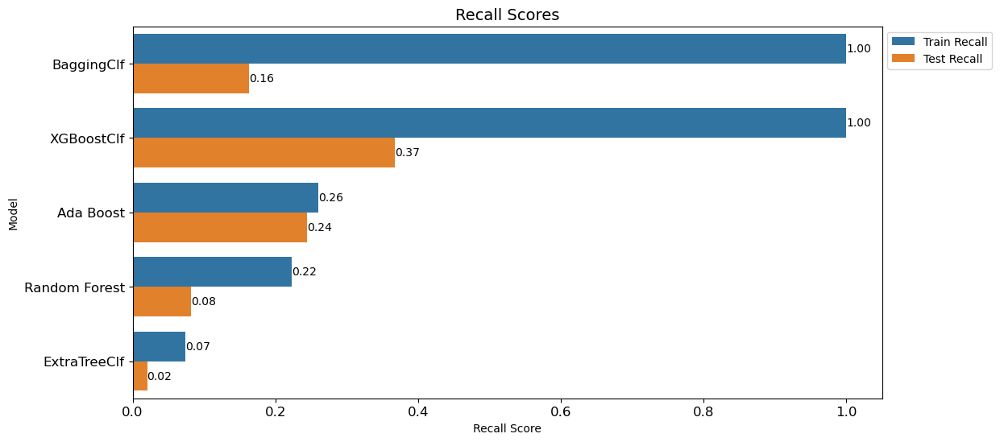

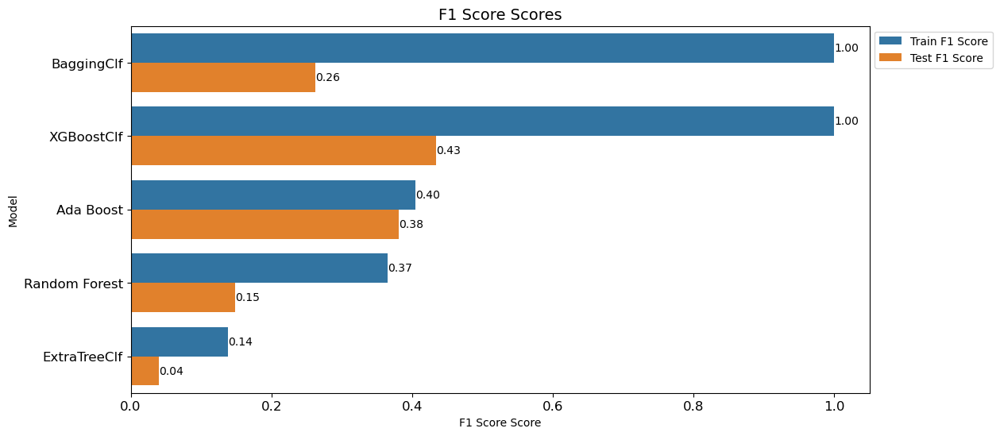

In [117]:
# Initialize a list to store model results
model_results = []

# Calculate metrics for each model
for model_name, model in models.items():
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    if hasattr(model, 'predict_proba'):
        y_train_proba = model.predict_proba(X_train)[:, 1]
        y_test_proba = model.predict_proba(X_test)[:, 1]
    else:
        y_train_proba = y_train_pred
        y_test_proba = y_test_pred
    
    results = {
        'Model': model_name,
        'Train ROC AUC': roc_auc_score(y_train, y_train_proba),
        'Test ROC AUC': roc_auc_score(y_test, y_test_proba),
        'Train Accuracy': accuracy_score(y_train, y_train_pred),
        'Test Accuracy': accuracy_score(y_test, y_test_pred),
        'Train Precision': precision_score(y_train, y_train_pred),
        'Test Precision': precision_score(y_test, y_test_pred),
        'Train Recall': recall_score(y_train, y_train_pred),
        'Test Recall': recall_score(y_test, y_test_pred),
        'Train F1 Score': f1_score(y_train, y_train_pred),
        'Test F1 Score': f1_score(y_test, y_test_pred)
    }
    
    model_results.append(results)

# Convert the results to a DataFrame
model_results_df = pd.DataFrame(model_results)

# Reshape the DataFrame for easier plotting
model_results_melted = model_results_df.melt(id_vars='Model', 
                                             value_vars=['Train ROC AUC', 'Test ROC AUC', 
                                                         'Train Accuracy', 'Test Accuracy', 
                                                         'Train Precision', 'Test Precision', 
                                                         'Train Recall', 'Test Recall', 
                                                         'Train F1 Score', 'Test F1 Score'],
                                             var_name='Metric', value_name='Score')

# Function to plot results for a specific metric
def plot_metric(metric):
    plt.figure(figsize=(12, 6))
    data = model_results_melted[model_results_melted['Metric'].str.contains(metric)]
    data = data.sort_values(by='Score', ascending=False)
    sns.barplot(data=data, x='Score', y='Model', hue='Metric', dodge=True)
    plt.title(f'{metric} Scores', fontsize=14)
    plt.ylabel('Model')
    plt.xlabel(f'{metric} Score')
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    
    for container in plt.gca().containers:
        plt.gca().bar_label(container, fmt='%.2f', label_type='edge')
    
    plt.show()

# Plot each metric separately
metrics = ['ROC AUC', 'Accuracy', 'Precision', 'Recall', 'F1 Score']
for metric in metrics:
    plot_metric(metric)


35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 767us/step
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 690us/step


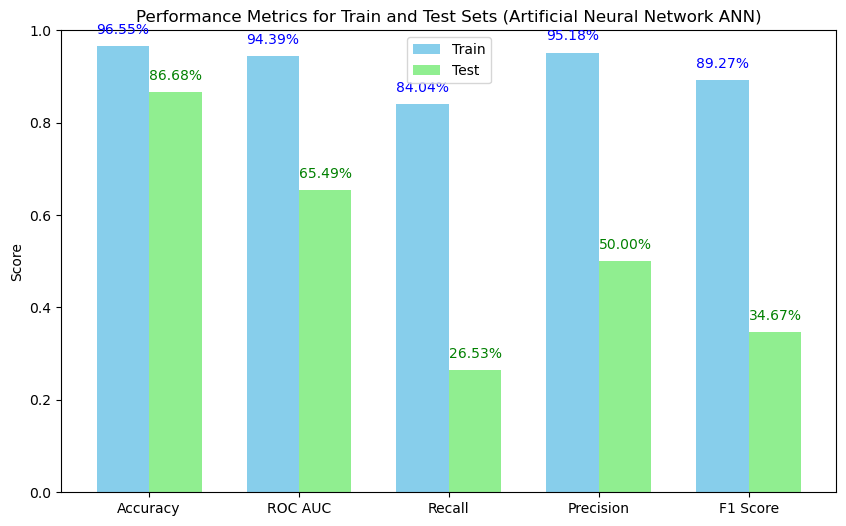

Accuracy: 86.68%
ROC AUC: 65.49%
Recall: 26.53%
Precision: 50.00%
F1 Score: 34.67%


In [128]:
# Results Neural Network
y_train_pred_proba = best_model.predict(X_train_preprocessed)
y_train_pred = (y_train_pred_proba > 0.5).astype(int)

y_test_pred_proba = best_model.predict(X_test_preprocessed)
y_test_pred = (y_test_pred_proba > 0.5).astype(int)

train_accuracy = accuracy_score(y_train, y_train_pred)
train_roc_auc = roc_auc_score(y_train, y_train_pred_proba)
train_recall = recall_score(y_train, y_train_pred)
train_precision = precision_score(y_train, y_train_pred)
train_f1 = f1_score(y_train, y_train_pred)

test_accuracy = accuracy_score(y_test, y_test_pred)
test_roc_auc = roc_auc_score(y_test, y_test_pred_proba)
test_recall = recall_score(y_test, y_test_pred)
test_precision = precision_score(y_test, y_test_pred)
test_f1 = f1_score(y_test, y_test_pred)

train_metrics = [train_accuracy, train_roc_auc, train_recall, train_precision, train_f1]
test_metrics = [test_accuracy, test_roc_auc, test_recall, test_precision, test_f1]
metric_names = ['Accuracy', 'ROC AUC', 'Recall', 'Precision', 'F1 Score']

x = np.arange(len(metric_names))
width = 0.35  # Ширина столбцов

fig, ax = plt.subplots(figsize=(10, 6))
bars1 = ax.bar(x - width/2, train_metrics, width, label='Train', color='skyblue')
bars2 = ax.bar(x + width/2, test_metrics, width, label='Test', color='lightgreen')

for bar in bars1:
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{yval:.2%}', ha='center', va='bottom', color='blue', fontsize=10)
for bar in bars2:
    yval = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2, yval + 0.02, f'{yval:.2%}', ha='center', va='bottom', color='green', fontsize=10)

ax.set_ylabel('Score')
ax.set_title('Performance Metrics for Train and Test Sets (Artificial Neural Network ANN)')
ax.set_xticks(x)
ax.set_xticklabels(metric_names)
ax.set_ylim(0, 1)
ax.legend()

plt.show()


for metric_name, metric_value in zip(metric_names, test_metrics):
    print(f"{metric_name}: {metric_value:.2%}")

In [131]:
# Results ML models
calculate_performance_metrics(models, X_train, y_train, X_test, y_test, list(models.keys()))

,Accuracy,Precision,Recall,F1 Score,ROC AUC
Ada Boost,0.894022,0.857143,0.244898,0.380952,0.619314
BaggingClf,0.877717,0.666667,0.163265,0.262295,0.575363
Random Forest,0.875000,0.800000,0.081633,0.148148,0.539249
XGBoostClf,0.872283,0.529412,0.367347,0.433735,0.658595
ExtraTreeClf,0.869565,1.000000,0.020408,0.040000,0.510204


5. Conclusion

From the results, it is evident that the model with the highest scores in terms of accuracy and ROC-AUC is the neural network. However, we suspect overfitting. The other machine learning models showed more stable results in terms of accuracy, ranging from 84% to 89% on average on both training and testing datasets. Overfitting is observed in other metrics such as recall, precision, and F1, particularly in neural networks. Test data values range from 30% to 92% for neural networks and from 10% to 40% for other machine learning models.

Заключение

Из результатов видно, что модель с самыми высокими показателями по метрикам accuracy и ROC-AUC — это нейронные сети, однако мы подозреваем переобучение. Остальные модели машинного обучения показали более стабильные результаты по метрикам accuracy , в среднем от 84 до 89 и 99% на тренировочных и тестовых наборах данных. По остальным метрикам, таким как recall, precision и F1, наблюдается переобучение, в нейронных сетях, где также наблюдается переобучение. Значения на тестовых данных варьируются от 30 до 92% для нейронных сетей и от 10 до 40% для других моделей машинного обучения.

Recommendations: To improve model accuracy, we need a balanced dataset, as our current dataset is unbalanced—the target variable is unevenly distributed. Specifically, 1 represents those who left the company and 0 represents those who stayed. There are 237 observations of 1 and 1233 observations of 0. This is one of the reasons for the low metric scores. Additionally, we can try processing the variables differently and specifying more parameters for the models.

Рекомендации: для повышения точности моделей необходимо использовать сбалансированный датасет, так как наш текущий датасет несбалансирован — целевая переменная распределена неравномерно. В частности, 1 означает тех, кто ушел из компании, и 0 — тех, кто остался. Значение 1 составляет 237 наблюдений, а значение 0 — 1233 наблюдения. Это является одной из причин низких показателей метрик. Можно также попробовать иначе обработать переменные и указать больше параметров для моделей.